<a href="https://colab.research.google.com/github/damar3c50/Flight-Airlines/blob/main/Flight_Airlines_Analysis.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
import plotly.express as px

warnings.filterwarnings('ignore')
%matplotlib inline

#Data Collect

In [2]:
df = pd.read_csv('/content/drive/MyDrive/Portofolio/Flight Airline Analysis/Flight Airlines Analysis/hflights.csv')
df.head()

,Year,Month,DayofMonth,DayOfWeek,DepTime,ArrTime,UniqueCarrier,FlightNum,TailNum,ActualElapsedTime,...,ArrDelay,DepDelay,Origin,Dest,Distance,TaxiIn,TaxiOut,Cancelled,CancellationCode,Diverted
0,2011,1,1,6,1400.0,1500.0,AA,428,N576AA,60.0,...,-10.0,0.0,IAH,DFW,224,7.0,13.0,0,NaN,0
1,2011,1,2,7,1401.0,1501.0,AA,428,N557AA,60.0,...,-9.0,1.0,IAH,DFW,224,6.0,9.0,0,NaN,0
2,2011,1,3,1,1352.0,1502.0,AA,428,N541AA,70.0,...,-8.0,-8.0,IAH,DFW,224,5.0,17.0,0,NaN,0
3,2011,1,4,2,1403.0,1513.0,AA,428,N403AA,70.0,...,3.0,3.0,IAH,DFW,224,9.0,22.0,0,NaN,0
4,2011,1,5,3,1405.0,1507.0,AA,428,N492AA,62.0,...,-3.0,5.0,IAH,DFW,224,9.0,9.0,0,NaN,0


In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 227496 entries, 0 to 227495
Data columns (total 21 columns):
 #   Column             Non-Null Count   Dtype  
---  ------             --------------   -----  
 0   Year               227496 non-null  int64  
 1   Month              227496 non-null  int64  
 2   DayofMonth         227496 non-null  int64  
 3   DayOfWeek          227496 non-null  int64  
 4   DepTime            224591 non-null  float64
 5   ArrTime            224430 non-null  float64
 6   UniqueCarrier      227496 non-null  object 
 7   FlightNum          227496 non-null  int64  
 8   TailNum            226701 non-null  object 
 9   ActualElapsedTime  223874 non-null  float64
 10  AirTime            223874 non-null  float64
 11  ArrDelay           223874 non-null  float64
 12  DepDelay           224591 non-null  float64
 13  Origin             227496 non-null  object 
 14  Dest               227496 non-null  object 
 15  Distance           227496 non-null  int64  
 16  Ta

#Problems & Hypothesis

In [ ]:
'''
Problems
Problem 1: Arrival Delays
Many flights experience significant arrival delays, leading to customer dissatisfaction and operational inefficiencies.
Question: What factors contribute most to arrival delays?

Problem 2: Impact of Cancellations and Diversions
Flights being cancelled or diverted disrupt schedules and cause economic losses.
Question: What patterns or factors increase the likelihood of flight cancellations or diversions?

Problem 3: Seasonal Demand and Performance
Flight performance may vary significantly based on the time of year (e.g., holidays or weather).
Question: How does seasonality (month or day of the week) affect delays?

Problem 4: Distance vs. Delays
Longer flights might have different delay patterns compared to shorter flights.
Question: Is there a relationship between flight distance and the likelihood or magnitude of delays?


Hypotheses
Hypothesis 1: Weather and Delays
Flights departing in winter months (e.g., December, January, February) are more likely to experience arrival delays due to adverse weather conditions.

Hypothesis 2: Cancellation Factors
Flights with longer scheduled departure times (e.g., late-night flights) are more likely to be cancelled or diverted due to operational challenges.

Hypothesis 4: Short Flights and Delays
Short-distance flights (e.g., <500 miles) are less likely to experience significant delays compared to long-distance flights.

Hypothesis 3: Day of Week and Delays
Flights on weekends (Saturday and Sunday) experience fewer delays compared to weekdays due to lighter air traffic.
'''

#Data Cleaning

In [5]:
df.head()

,Year,Month,DayofMonth,DayOfWeek,DepTime,ArrTime,UniqueCarrier,FlightNum,TailNum,ActualElapsedTime,...,ArrDelay,DepDelay,Origin,Dest,Distance,TaxiIn,TaxiOut,Cancelled,CancellationCode,Diverted
0,2011,1,1,6,1400.0,1500.0,AA,428,N576AA,60.0,...,-10.0,0.0,IAH,DFW,224,7.0,13.0,0,NaN,0
1,2011,1,2,7,1401.0,1501.0,AA,428,N557AA,60.0,...,-9.0,1.0,IAH,DFW,224,6.0,9.0,0,NaN,0
2,2011,1,3,1,1352.0,1502.0,AA,428,N541AA,70.0,...,-8.0,-8.0,IAH,DFW,224,5.0,17.0,0,NaN,0
3,2011,1,4,2,1403.0,1513.0,AA,428,N403AA,70.0,...,3.0,3.0,IAH,DFW,224,9.0,22.0,0,NaN,0
4,2011,1,5,3,1405.0,1507.0,AA,428,N492AA,62.0,...,-3.0,5.0,IAH,DFW,224,9.0,9.0,0,NaN,0


In [6]:
#Mengubah nama kolom dari uppercase menjadi lowercase
df.columns = df.columns.str.lower()
df.head()

,year,month,dayofmonth,dayofweek,deptime,arrtime,uniquecarrier,flightnum,tailnum,actualelapsedtime,...,arrdelay,depdelay,origin,dest,distance,taxiin,taxiout,cancelled,cancellationcode,diverted
0,2011,1,1,6,1400.0,1500.0,AA,428,N576AA,60.0,...,-10.0,0.0,IAH,DFW,224,7.0,13.0,0,NaN,0
1,2011,1,2,7,1401.0,1501.0,AA,428,N557AA,60.0,...,-9.0,1.0,IAH,DFW,224,6.0,9.0,0,NaN,0
2,2011,1,3,1,1352.0,1502.0,AA,428,N541AA,70.0,...,-8.0,-8.0,IAH,DFW,224,5.0,17.0,0,NaN,0
3,2011,1,4,2,1403.0,1513.0,AA,428,N403AA,70.0,...,3.0,3.0,IAH,DFW,224,9.0,22.0,0,NaN,0
4,2011,1,5,3,1405.0,1507.0,AA,428,N492AA,62.0,...,-3.0,5.0,IAH,DFW,224,9.0,9.0,0,NaN,0


In [7]:
# deptime, arrtime -> bentuknya waktu (23.54)
# actualelapsetime, airtime, arrdelay, depdelay, taxiin, taxiout -> bentuknya menit
# buat kolom baru 'Date' dari kolom year + month + day
# membetulkan value dari kolom deptime, arrtime menjadi bentuk waktu
# ganti beberapa tipe data untuk beberapa kolom
# menghandle nilai kososng
# menghandle nilai outlier
# menghandle nilai duplikat
# menghapus kolom yang tidak penting untuk digunakan
# urutkan kolom agar mudah dipahami

In [8]:
df['deptime'] = df['deptime'] / 100
df['deptime'] = df['deptime'].apply(lambda x: f"{x:05.2f}" if pd.notnull(x) else None)
df['arrtime'] = df['arrtime'] / 100
df['arrtime'] = df['arrtime'].apply(lambda x: f'{x:05.2f}' if pd.notnull(x) else None)

In [9]:
df['date'] = df['year'].astype('str') + '-' + df['month'].astype('str') + '-' + df['dayofmonth'].astype('str')
df['date'] = pd.to_datetime(df['date'])
df.iloc[:, 0:10].head()

,year,month,dayofmonth,dayofweek,deptime,arrtime,uniquecarrier,flightnum,tailnum,actualelapsedtime
0,2011,1,1,6,14.00,15.00,AA,428,N576AA,60.0
1,2011,1,2,7,14.01,15.01,AA,428,N557AA,60.0
2,2011,1,3,1,13.52,15.02,AA,428,N541AA,70.0
3,2011,1,4,2,14.03,15.13,AA,428,N403AA,70.0
4,2011,1,5,3,14.05,15.07,AA,428,N492AA,62.0


In [10]:
df.iloc[:, 10:].head()

,airtime,arrdelay,depdelay,origin,dest,distance,taxiin,taxiout,cancelled,cancellationcode,diverted,date
0,40.0,-10.0,0.0,IAH,DFW,224,7.0,13.0,0,NaN,0,2011-01-01
1,45.0,-9.0,1.0,IAH,DFW,224,6.0,9.0,0,NaN,0,2011-01-02
2,48.0,-8.0,-8.0,IAH,DFW,224,5.0,17.0,0,NaN,0,2011-01-03
3,39.0,3.0,3.0,IAH,DFW,224,9.0,22.0,0,NaN,0,2011-01-04
4,44.0,-3.0,5.0,IAH,DFW,224,9.0,9.0,0,NaN,0,2011-01-05


In [11]:
#Mengubah tipe data pada beberapa kolom
df['actualelapsedtime'] = df['actualelapsedtime'].fillna(0).astype('int')
df['airtime'] = df['airtime'].fillna(0).astype('int')
df['arrdelay'] = df['arrdelay'].fillna(0).astype('int')
df['depdelay'] = df['depdelay'].fillna(0).astype('int')
df['taxiin'] = df['taxiin'].fillna(0).astype('int')
df['taxiout'] = df['taxiout'].fillna(0).astype('int')
df['cancelled'] = df['cancelled'].astype('object')
df['diverted'] = df['diverted'].astype('object')
df['arrtime'] = df['arrtime'].str.replace('.', ':', regex=False)
df['deptime'] = df['deptime'].str.replace('.', ':', regex=False)

df['arrtime'] = pd.to_datetime(df['arrtime'], format='%H:%M', errors='coerce').dt.time
df['deptime'] = pd.to_datetime(df['deptime'], format='%H:%M', errors='coerce').dt.time

In [12]:
df.isnull().sum()

,0
year,0
month,0
dayofmonth,0
dayofweek,0
deptime,2906
arrtime,3112
uniquecarrier,0
flightnum,0
tailnum,795
actualelapsedtime,0


In [13]:
#Menghandle nilai null pada dataset
df['cancellationcode'] = df['cancellationcode'].fillna('-')
df = df.dropna(axis=0)

In [14]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 224383 entries, 0 to 227495
Data columns (total 22 columns):
 #   Column             Non-Null Count   Dtype         
---  ------             --------------   -----         
 0   year               224383 non-null  int64         
 1   month              224383 non-null  int64         
 2   dayofmonth         224383 non-null  int64         
 3   dayofweek          224383 non-null  int64         
 4   deptime            224383 non-null  object        
 5   arrtime            224383 non-null  object        
 6   uniquecarrier      224383 non-null  object        
 7   flightnum          224383 non-null  int64         
 8   tailnum            224383 non-null  object        
 9   actualelapsedtime  224383 non-null  int64         
 10  airtime            224383 non-null  int64         
 11  arrdelay           224383 non-null  int64         
 12  depdelay           224383 non-null  int64         
 13  origin             224383 non-null  object       

In [15]:
df.isnull().sum()

,0
year,0
month,0
dayofmonth,0
dayofweek,0
deptime,0
arrtime,0
uniquecarrier,0
flightnum,0
tailnum,0
actualelapsedtime,0


In [16]:
df.duplicated().sum()

0

<Axes: xlabel='taxiout'>

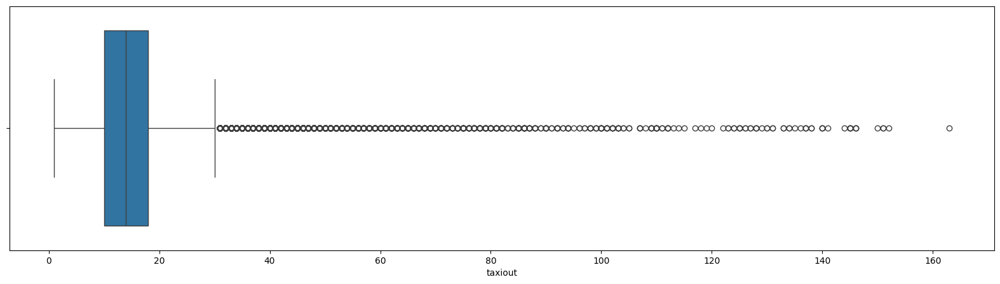

In [17]:
plt.figure(figsize=(20,5))
sns.boxplot(data=df,x='taxiout')

<Axes: xlabel='taxiin'>

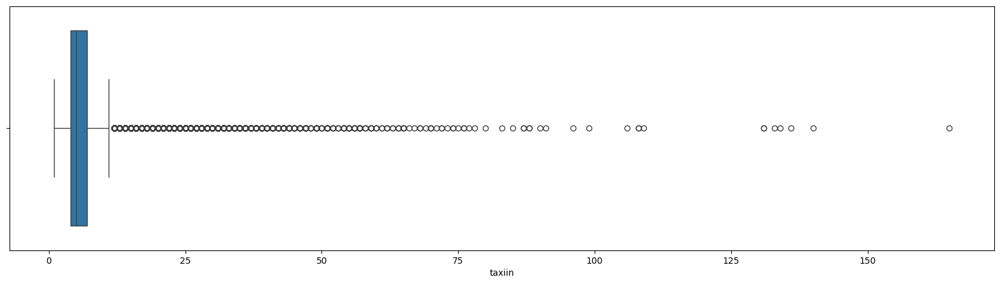

In [18]:
plt.figure(figsize=(20,5))
sns.boxplot(data=df,x='taxiin')

<Axes: xlabel='arrdelay'>

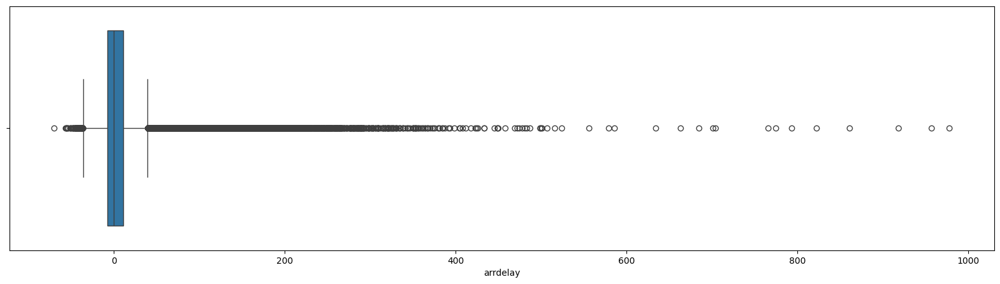

In [19]:
plt.figure(figsize=(20,5))
sns.boxplot(data=df,x='arrdelay')

<Axes: xlabel='depdelay'>

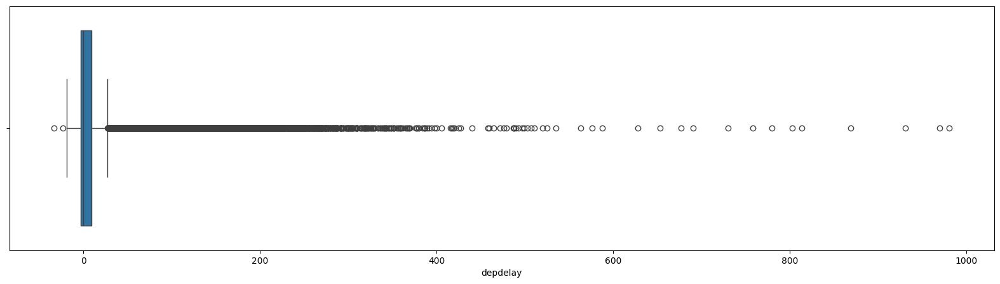

In [20]:
plt.figure(figsize=(20,5))
sns.boxplot(data=df,x='depdelay')

In [21]:
#Menghandle outlier dengan teknik capping
x = df[['arrdelay', 'depdelay', 'taxiin', 'taxiout']].columns
# Calculate Q1 and Q3 for the selected numeric columns
Q1 = df[x].quantile(0.25)
Q3 = df[x].quantile(0.75)

# Calculate IQR, maximum, and minimum for outlier handling
IQR = Q3 - Q1
maximum = Q3 + (1.5 * IQR)
minimum = Q1 - (1.5 * IQR)

data = {'integer_column': ['arrdelay', 'depdelay', 'taxiin', 'taxiout'],
        'count_>_maximum': [df[df['arrdelay'] > maximum.iloc[0]]['arrdelay'].count(), df[df['depdelay'] > maximum.iloc[1]]['depdelay'].count(), df[df['taxiin'] > maximum.iloc[2]]['taxiin'].count(), df[df['taxiout'] > maximum.iloc[3]]['taxiout'].count()],
        'count_<_minimum': [df[df['arrdelay'] < minimum.iloc[0]]['arrdelay'].count(), df[df['depdelay'] < minimum.iloc[1]]['depdelay'].count(), df[df['taxiin'] < minimum.iloc[2]]['taxiin'].count(), df[df['taxiout'] < minimum.iloc[3]]['taxiout'].count()]}

outlier_count = pd.DataFrame(data)
outlier_count['total_outliers'] = outlier_count['count_>_maximum'] + outlier_count['count_<_minimum']
outlier_count['percentages'] = round((outlier_count['total_outliers'] / 224430) * 100,2)
outlier_count

,integer_column,count_>_maximum,count_<_minimum,total_outliers,percentages
0,arrdelay,17716,212,17928,7.99
1,depdelay,25112,2,25114,11.19
2,taxiin,14370,0,14370,6.40
3,taxiout,7904,0,7904,3.52


In [22]:
# Define a threshold for considering data points as outliers (e.g., 1.5 for a standard threshold)
iqr_threshold = 1.5 #dari rumus

# Filter columns with numeric data types
x = df[['arrdelay', 'depdelay', 'taxiin', 'taxiout']].columns

#di run 3 kali agar data bebas dari outliers
iterations = 0
while iterations < 3:
    for column in x:
        q1 = df[column].quantile(0.25)
        q3 = df[column].quantile(0.75)
        iqr = q3 - q1

        lower_bound = q1 - iqr_threshold * iqr
        upper_bound = q3 + iqr_threshold * iqr

        # Remove outliers from the current column
        df = df[(df[column] >= lower_bound) & (df[column] <= upper_bound)]

    iterations += 1


In [23]:
df.isnull().sum()

,0
year,0
month,0
dayofmonth,0
dayofweek,0
deptime,0
arrtime,0
uniquecarrier,0
flightnum,0
tailnum,0
actualelapsedtime,0


In [24]:
df[['arrdelay', 'depdelay', 'taxiin', 'taxiout']].describe()

,arrdelay,depdelay,taxiin,taxiout
count,149250.000000,149250.000000,149250.000000,149250.000000
mean,-4.134754,-0.796067,5.368549,14.231464
std,8.846931,4.101273,2.077448,5.301285
min,-28.000000,-10.000000,1.000000,1.000000
25%,-10.000000,-4.000000,4.000000,10.000000
50%,-4.000000,-1.000000,5.000000,14.000000
75%,2.000000,2.000000,7.000000,18.000000
max,20.000000,9.000000,11.000000,30.000000


<Axes: xlabel='taxiout'>

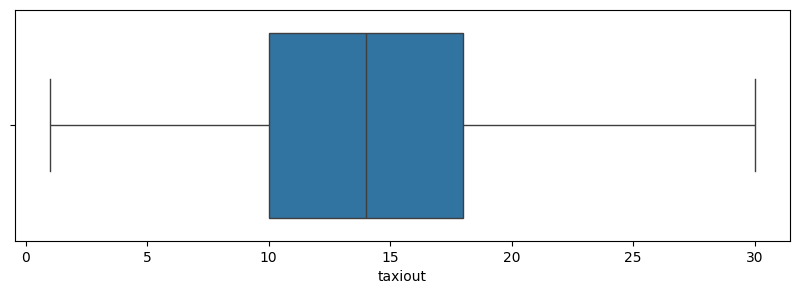

In [25]:
plt.figure(figsize=(10,3))
sns.boxplot(data=df,x='taxiout')

<Axes: xlabel='taxiin'>

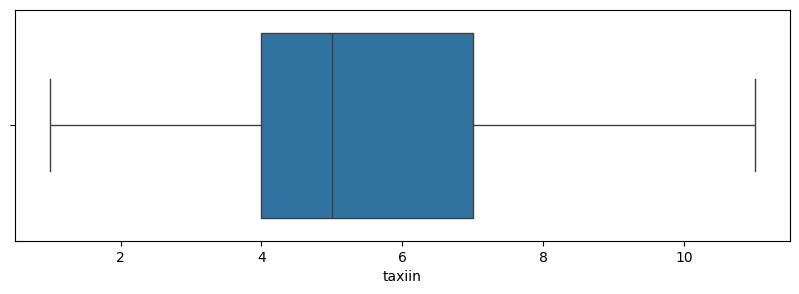

In [26]:
plt.figure(figsize=(10,3))
sns.boxplot(data=df,x='taxiin')

<Axes: xlabel='arrdelay'>

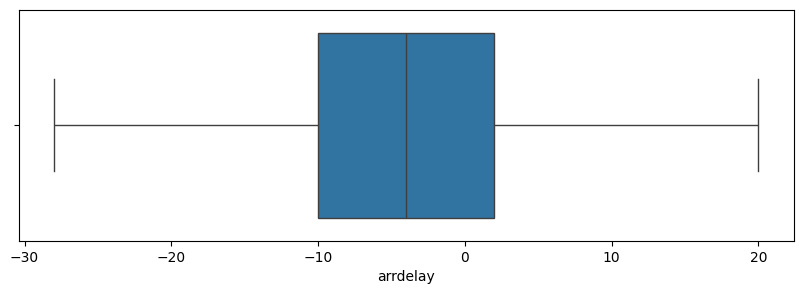

In [27]:
plt.figure(figsize=(10,3))
sns.boxplot(data=df,x='arrdelay')

<Axes: xlabel='depdelay'>

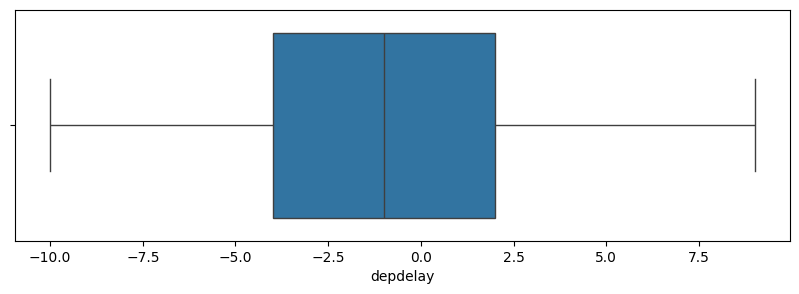

In [28]:
plt.figure(figsize=(10,3))
sns.boxplot(data=df,x='depdelay')

In [29]:
df.iloc[:,0:10].head()

,year,month,dayofmonth,dayofweek,deptime,arrtime,uniquecarrier,flightnum,tailnum,actualelapsedtime
0,2011,1,1,6,14:00:00,15:00:00,AA,428,N576AA,60
1,2011,1,2,7,14:01:00,15:01:00,AA,428,N557AA,60
2,2011,1,3,1,13:52:00,15:02:00,AA,428,N541AA,70
3,2011,1,4,2,14:03:00,15:13:00,AA,428,N403AA,70
4,2011,1,5,3,14:05:00,15:07:00,AA,428,N492AA,62


In [30]:
df.iloc[:, 10:].head()

,airtime,arrdelay,depdelay,origin,dest,distance,taxiin,taxiout,cancelled,cancellationcode,diverted,date
0,40,-10,0,IAH,DFW,224,7,13,0,-,0,2011-01-01
1,45,-9,1,IAH,DFW,224,6,9,0,-,0,2011-01-02
2,48,-8,-8,IAH,DFW,224,5,17,0,-,0,2011-01-03
3,39,3,3,IAH,DFW,224,9,22,0,-,0,2011-01-04
4,44,-3,5,IAH,DFW,224,9,9,0,-,0,2011-01-05


In [31]:
df  = df[['date', 'uniquecarrier', 'flightnum', 'tailnum', 'taxiout', 'deptime', 'depdelay', 'arrtime', 'arrdelay', 'taxiin', 'origin', 'dest', 'distance', 'actualelapsedtime', 'airtime', 'cancelled', 'cancellationcode', 'diverted', 'year', 'month', 'dayofmonth', 'dayofweek']]
df.head()

,date,uniquecarrier,flightnum,tailnum,taxiout,deptime,depdelay,arrtime,arrdelay,taxiin,...,distance,actualelapsedtime,airtime,cancelled,cancellationcode,diverted,year,month,dayofmonth,dayofweek
0,2011-01-01,AA,428,N576AA,13,14:00:00,0,15:00:00,-10,7,...,224,60,40,0,-,0,2011,1,1,6
1,2011-01-02,AA,428,N557AA,9,14:01:00,1,15:01:00,-9,6,...,224,60,45,0,-,0,2011,1,2,7
2,2011-01-03,AA,428,N541AA,17,13:52:00,-8,15:02:00,-8,5,...,224,70,48,0,-,0,2011,1,3,1
3,2011-01-04,AA,428,N403AA,22,14:03:00,3,15:13:00,3,9,...,224,70,39,0,-,0,2011,1,4,2
4,2011-01-05,AA,428,N492AA,9,14:05:00,5,15:07:00,-3,9,...,224,62,44,0,-,0,2011,1,5,3


#Explanatory Data Analysis

###Univariate EDA

**NUMERICAL**

array([[<Axes: title={'center': 'flightnum'}>,
        <Axes: title={'center': 'taxiout'}>,
        <Axes: title={'center': 'depdelay'}>],
       [<Axes: title={'center': 'arrdelay'}>,
        <Axes: title={'center': 'taxiin'}>,
        <Axes: title={'center': 'distance'}>],
       [<Axes: title={'center': 'actualelapsedtime'}>,
        <Axes: title={'center': 'airtime'}>, <Axes: >]], dtype=object)

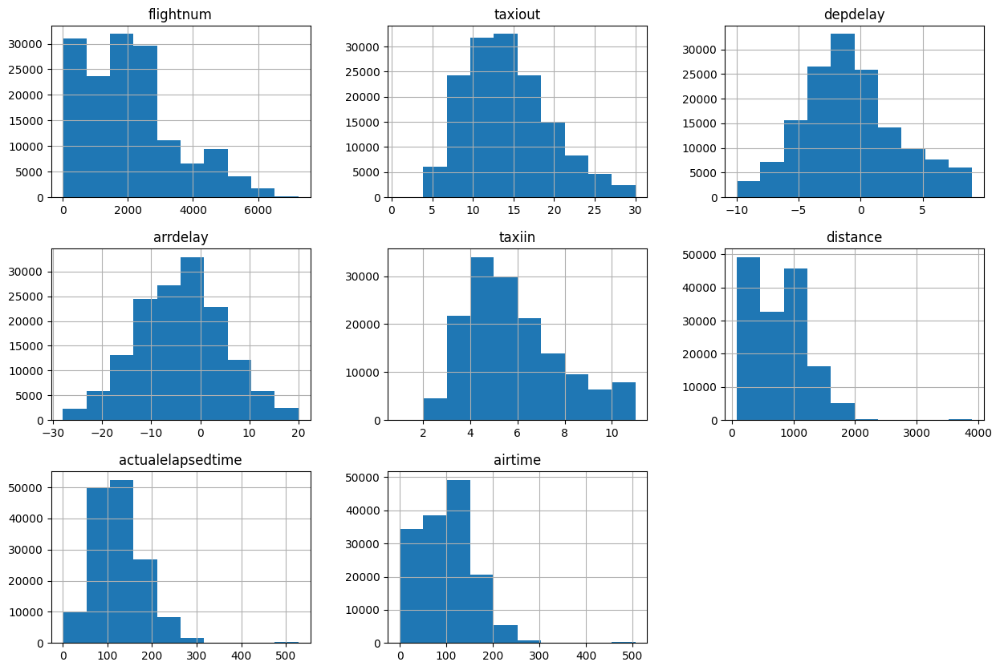

In [32]:
df[['flightnum', 'taxiout', 'depdelay','arrdelay','taxiin','distance', 'actualelapsedtime', 'airtime']].hist(bins= 10,figsize=(15,10))

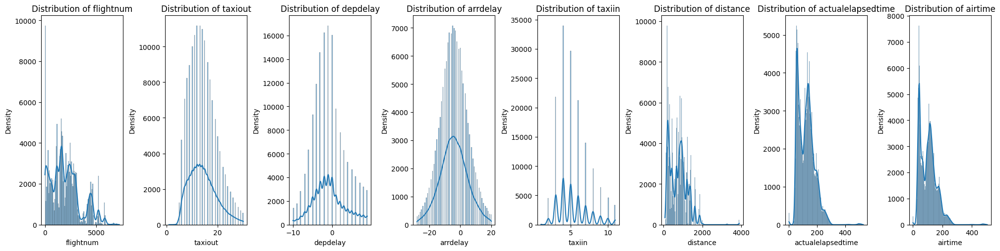

In [33]:
# Filter columns with numeric data types
numeric_columns = df[['flightnum', 'taxiout', 'depdelay', 'arrdelay', 'taxiin', 'distance', 'actualelapsedtime', 'airtime']].columns

# Create distribution plots for numeric columns
fig, axs = plt.subplots(ncols=len(numeric_columns), figsize=(20, 5))

for i, column in enumerate(numeric_columns):
    sns.histplot(df[column], kde=True, ax=axs[i])
    axs[i].set_title(f'Distribution of {column}')
    axs[i].set_xlabel(column)
    axs[i].set_ylabel('Density')

plt.tight_layout(pad=0.4, w_pad=0.5, h_pad=1.0)
plt.show()

**CATEGORICAL**

In [34]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 149250 entries, 0 to 227495
Data columns (total 22 columns):
 #   Column             Non-Null Count   Dtype         
---  ------             --------------   -----         
 0   date               149250 non-null  datetime64[ns]
 1   uniquecarrier      149250 non-null  object        
 2   flightnum          149250 non-null  int64         
 3   tailnum            149250 non-null  object        
 4   taxiout            149250 non-null  int64         
 5   deptime            149250 non-null  object        
 6   depdelay           149250 non-null  int64         
 7   arrtime            149250 non-null  object        
 8   arrdelay           149250 non-null  int64         
 9   taxiin             149250 non-null  int64         
 10  origin             149250 non-null  object        
 11  dest               149250 non-null  object        
 12  distance           149250 non-null  int64         
 13  actualelapsedtime  149250 non-null  int64        

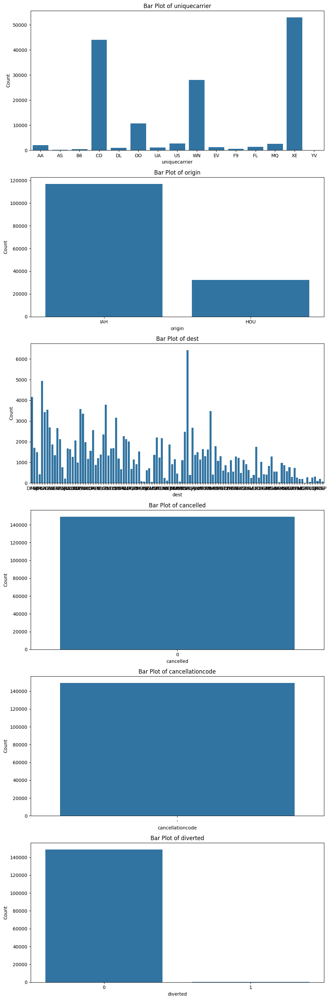

In [35]:
categorical_columns = df[['uniquecarrier','origin', 'dest','cancelled', 'cancellationcode', 'diverted']].columns

# Create bar plots for categorical columns
fig, axs = plt.subplots(nrows=len(categorical_columns), figsize=(10, 5 * len(categorical_columns)))

for i, column in enumerate(categorical_columns):
    sns.countplot(x=df[column], ax=axs[i])
    axs[i].set_title(f'Bar Plot of {column}')
    axs[i].set_xlabel(column)
    axs[i].set_ylabel('Count')

plt.tight_layout()
plt.show()

<Axes: xlabel='origin', ylabel='count'>

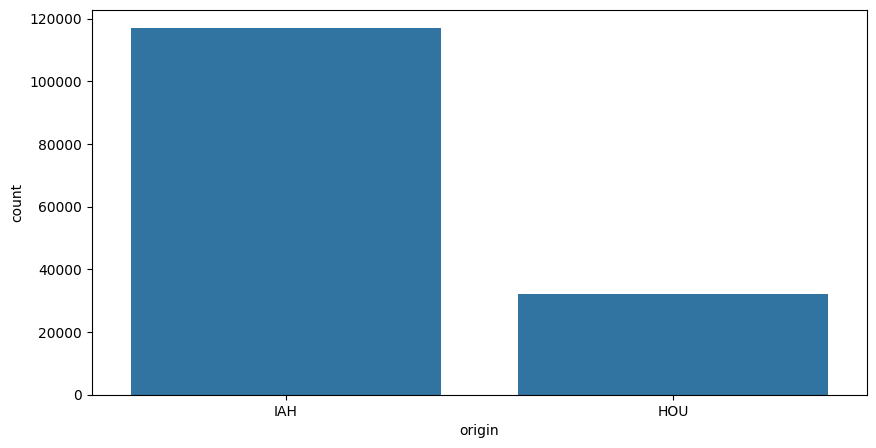

In [36]:
plt.figure(figsize=(10,5))
sns.countplot(data=df, x='origin')

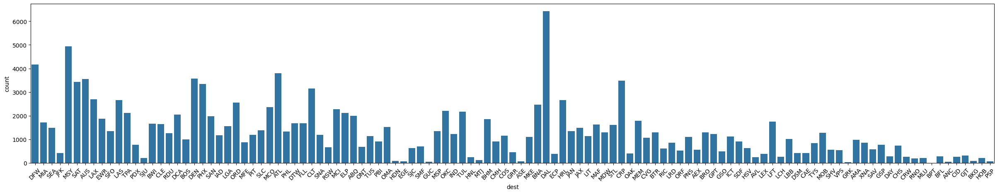

In [37]:
plt.figure(figsize=(30,5))
sns.countplot(data=df, x='dest')
plt.xticks(rotation=45)
plt.show()

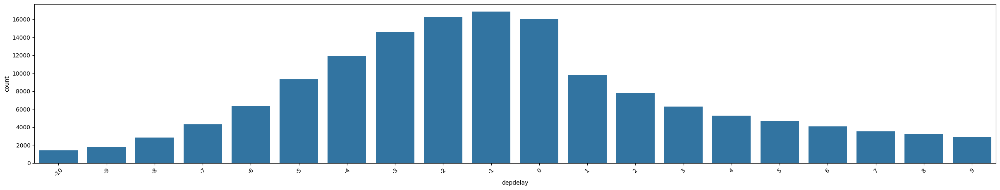

In [38]:
plt.figure(figsize=(30,5))
sns.countplot(data=df, x='depdelay')
plt.xticks(rotation=45)
plt.show()

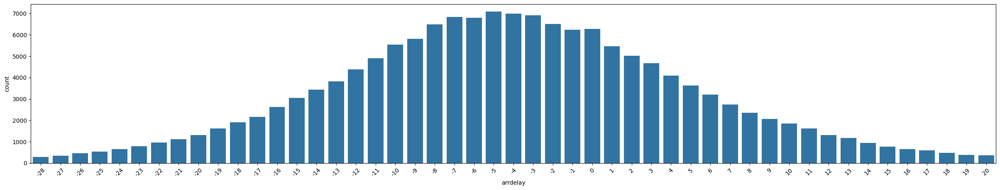

In [39]:
plt.figure(figsize=(30,5))
sns.countplot(data=df, x='arrdelay')
plt.xticks(rotation=45)
plt.show()

In [40]:
# Notes
'''
- Pesawat dengan kode XE menjadi pesawat dengan jumlah penerbangan terbanyak, diikuti oleh CO dan WN
- Penerbangan paling banyak terjadi dari Bandara IAH
- Dan tujuan dari penerbangan paling banyak menuju ke bandara DAL, MSY, DFW
- Dari penerbangan ini tidak terjadi adanya pembatalan tetapi terdapat beberapa penerbangan yang mengalami diverted
- keberangkatan pesawat lebih awal 1 menit dari jadwal yang sudah ditentukan
- kedatangan pesawat lebih awal sekitar 5 menit dari jadwal yang sudah ditentukan
'''

'\n- Pesawat dengan kode XE menjadi pesawat dengan jumlah penerbangan terbanyak, diikuti oleh CO dan WN\n- Penerbangan paling banyak terjadi dari Bandara IAH\n- Dan tujuan dari penerbangan paling banyak menuju ke bandara DAL, MSY, DFW\n- Dari penerbangan ini tidak terjadi adanya pembatalan tetapi terdapat beberapa penerbangan yang mengalami diverted\n- keberangkatan pesawat lebih awal 1 menit dari jadwal yang sudah ditentukan\n- kedatangan pesawat lebih awal sekitar 5 menit dari jadwal yang sudah ditentukan\n'

###Bivariate EDA

**NUMERIC VS NUMERIC**

In [41]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 149250 entries, 0 to 227495
Data columns (total 22 columns):
 #   Column             Non-Null Count   Dtype         
---  ------             --------------   -----         
 0   date               149250 non-null  datetime64[ns]
 1   uniquecarrier      149250 non-null  object        
 2   flightnum          149250 non-null  int64         
 3   tailnum            149250 non-null  object        
 4   taxiout            149250 non-null  int64         
 5   deptime            149250 non-null  object        
 6   depdelay           149250 non-null  int64         
 7   arrtime            149250 non-null  object        
 8   arrdelay           149250 non-null  int64         
 9   taxiin             149250 non-null  int64         
 10  origin             149250 non-null  object        
 11  dest               149250 non-null  object        
 12  distance           149250 non-null  int64         
 13  actualelapsedtime  149250 non-null  int64        

In [42]:
df.head()

,date,uniquecarrier,flightnum,tailnum,taxiout,deptime,depdelay,arrtime,arrdelay,taxiin,...,distance,actualelapsedtime,airtime,cancelled,cancellationcode,diverted,year,month,dayofmonth,dayofweek
0,2011-01-01,AA,428,N576AA,13,14:00:00,0,15:00:00,-10,7,...,224,60,40,0,-,0,2011,1,1,6
1,2011-01-02,AA,428,N557AA,9,14:01:00,1,15:01:00,-9,6,...,224,60,45,0,-,0,2011,1,2,7
2,2011-01-03,AA,428,N541AA,17,13:52:00,-8,15:02:00,-8,5,...,224,70,48,0,-,0,2011,1,3,1
3,2011-01-04,AA,428,N403AA,22,14:03:00,3,15:13:00,3,9,...,224,70,39,0,-,0,2011,1,4,2
4,2011-01-05,AA,428,N492AA,9,14:05:00,5,15:07:00,-3,9,...,224,62,44,0,-,0,2011,1,5,3


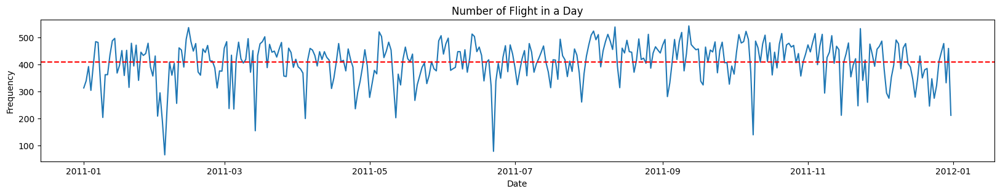

In [43]:
x = df.groupby('date')['year'].count().reset_index()
plt.figure(figsize=(20, 3))
sns.lineplot(data=x, x='date', y='year')
plt.title('Number of Flight in a Day')
plt.xlabel('Date')
plt.ylabel('Frequency')

y = round(x['year'].mean(),2)
plt.axhline(y=y,
            color='r',
            linestyle='--')

Text(0, 0.5, 'Arrival Delay')

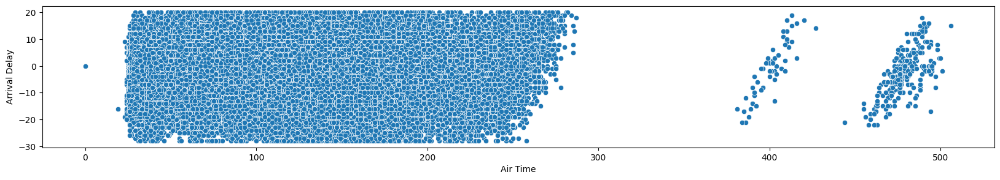

In [44]:
plt.figure(figsize=(20,3))
sns.scatterplot(data=df, x='airtime', y='arrdelay')
plt.xlabel('Air Time')
plt.ylabel('Arrival Delay')

Text(0, 0.5, 'Departure Delay')

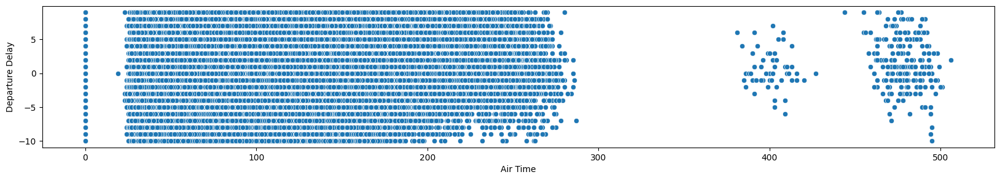

In [45]:
plt.figure(figsize=(20,3))
sns.scatterplot(data=df, x='airtime', y='depdelay')
plt.xlabel('Air Time')
plt.ylabel('Departure Delay')

Text(0, 0.5, 'Arrival Delay')

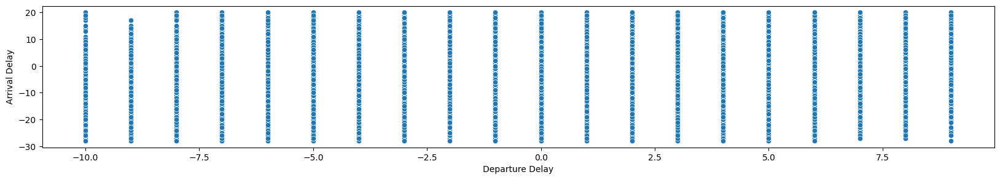

In [46]:
plt.figure(figsize=(20,3))
sns.scatterplot(data=df, x='depdelay', y='arrdelay')
plt.xlabel('Departure Delay')
plt.ylabel('Arrival Delay')

Text(0, 0.5, 'Air Time')

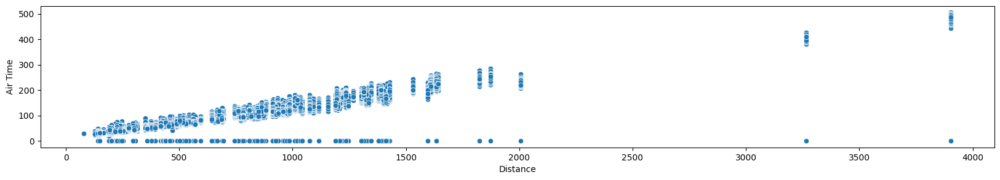

In [47]:
plt.figure(figsize=(20,3))
sns.scatterplot(data=df, x='distance', y='airtime')
plt.xlabel('Distance')
plt.ylabel('Air Time')

Text(0, 0.5, 'Departure Delay')

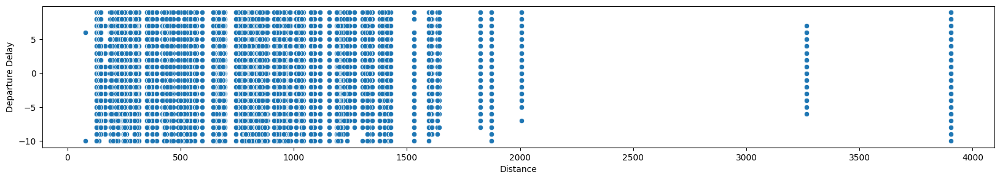

In [48]:
plt.figure(figsize=(20,3))
sns.scatterplot(data=df, x='distance', y='depdelay')
plt.xlabel('Distance')
plt.ylabel('Departure Delay')

Text(0, 0.5, 'Arrival Delay')

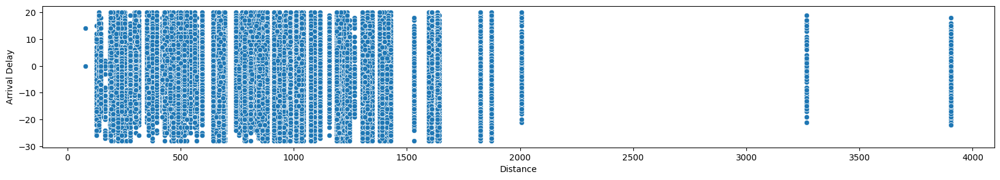

In [49]:
plt.figure(figsize=(20,3))
sns.scatterplot(data=df, x='distance', y='arrdelay')
plt.xlabel('Distance')
plt.ylabel('Arrival Delay')

Text(0, 0.5, 'Air Time')

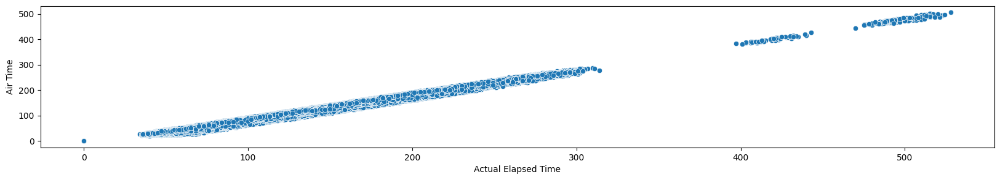

In [50]:
plt.figure(figsize=(20,3))
sns.scatterplot(data=df, x='actualelapsedtime', y='airtime')
plt.xlabel('Actual Elapsed Time')
plt.ylabel('Air Time')

Text(0, 0.5, 'Distance')

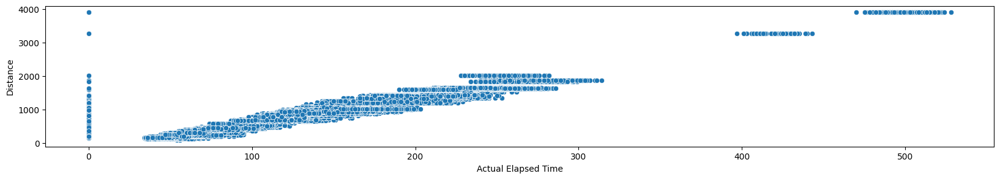

In [51]:
plt.figure(figsize=(20,3))
sns.scatterplot(data=df, x='actualelapsedtime', y='distance')
plt.xlabel('Actual Elapsed Time')
plt.ylabel('Distance')

(array([0.5, 1.5, 2.5, 3.5, 4.5, 5.5, 6.5]),
 [Text(0.5, 0, 'taxiout'),
  Text(1.5, 0, 'depdelay'),
  Text(2.5, 0, 'arrdelay'),
  Text(3.5, 0, 'taxiin'),
  Text(4.5, 0, 'distance'),
  Text(5.5, 0, 'actualelapsedtime'),
  Text(6.5, 0, 'airtime')])

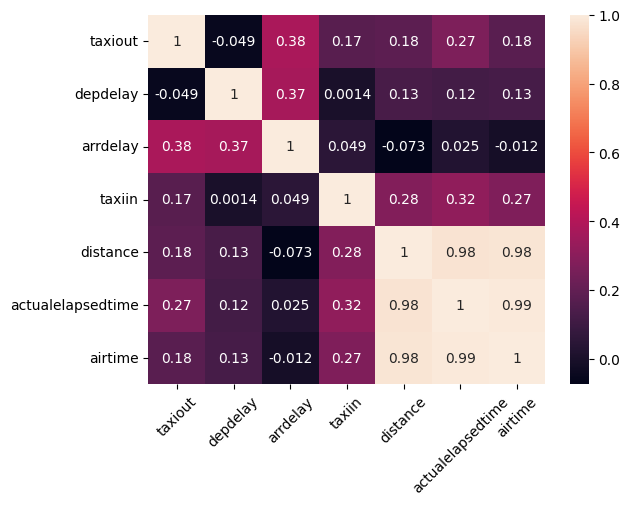

In [52]:
numerical_columns = df[['taxiout', 'depdelay', 'arrdelay', 'taxiin','distance', 'actualelapsedtime', 'airtime']]
sns.heatmap(numerical_columns.corr(), annot=True)
plt.xticks(rotation=45)

In [53]:
#Notes
'''
- sebanyak 56% penerbangan yang terjadi sehari-hari memiliki jumlah diatas rata-rata
- distance dan air time memiliki hubungan yang positf, terdapat penerbangan yang tidak memiliki air time karena terdapat kemungkinan bahwa penerbangan tersebut diverted
- actual elapse time dengan air time memiliki hubungan yang positif
- actual elapse time dengan distance memiliki hubungan yang positif dan terdapat penerbangan yang tidak memiliki actual elapse time tetapi distance-nya cukup jauh, hal ini dapat terjadi
karena ada kemungkinan bahwa penerbangan tersebut termasuk diverted
'''

'\n- sebanyak 56% penerbangan yang terjadi sehari-hari memiliki jumlah diatas rata-rata\n- distance dan air time memiliki hubungan yang positf, terdapat penerbangan yang tidak memiliki air time karena terdapat kemungkinan bahwa penerbangan tersebut diverted\n- actual elapse time dengan air time memiliki hubungan yang positif\n- actual elapse time dengan distance memiliki hubungan yang positif dan terdapat penerbangan yang tidak memiliki actual elapse time tetapi distance-nya cukup jauh, hal ini dapat terjadi\nkarena ada kemungkinan bahwa penerbangan tersebut termasuk diverted\n'

**NUMERIC VS CATEGORICAL**

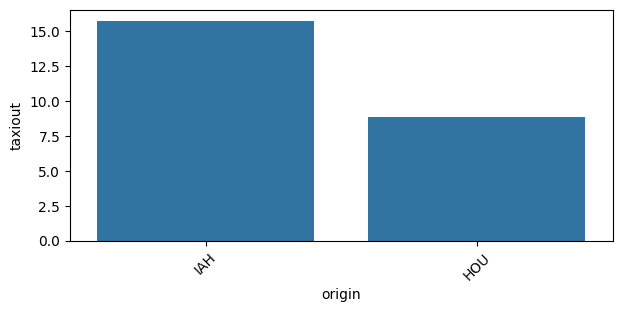

In [54]:
plt.figure(figsize=(7,3))
sns.barplot(data=df, x='origin', y='taxiout', errorbar=None)
plt.xticks(rotation=45)
plt.show()

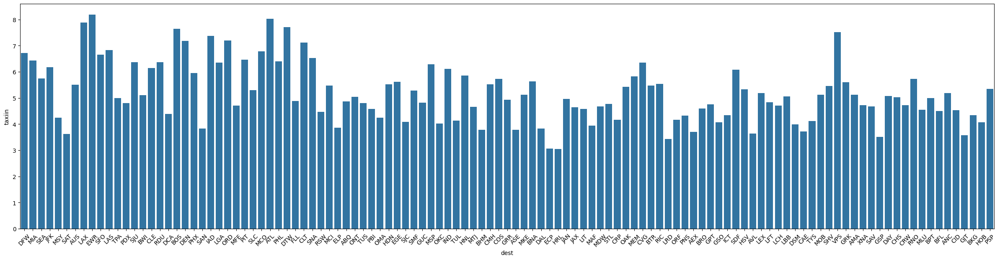

In [55]:
plt.figure(figsize=(30,7))
sns.barplot(data=df, x='dest', y='taxiin', errorbar=None)
plt.xticks(rotation=45)
plt.show()

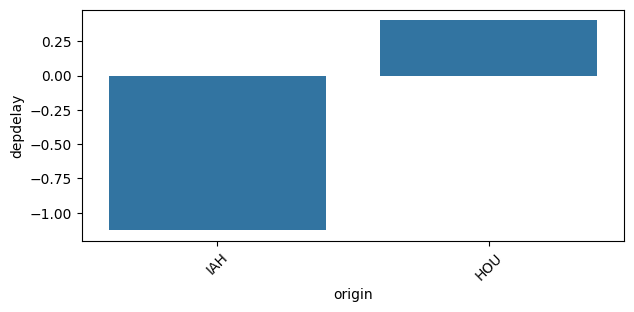

In [56]:
plt.figure(figsize=(7, 3))
sns.barplot(data=df, x='origin', y='depdelay', errorbar=None)
plt.xticks(rotation=45)
plt.show()

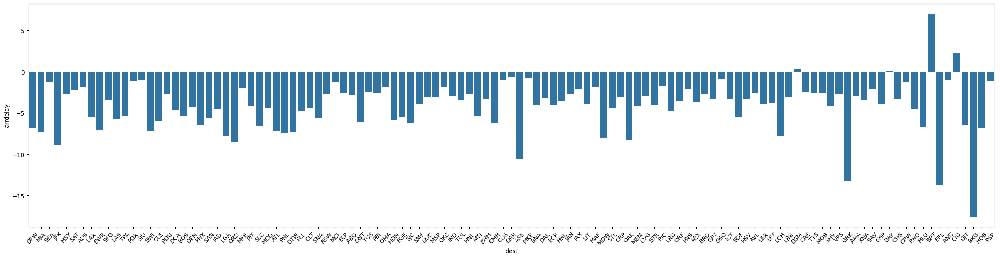

In [57]:
plt.figure(figsize=(30,7))
sns.barplot(data=df, x='dest', y='arrdelay', errorbar=None)
plt.xticks(rotation=45)
plt.show()

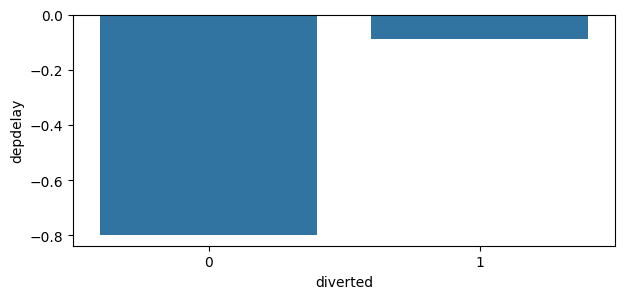

In [58]:
plt.figure(figsize=(7, 3))
sns.barplot(data=df, x='diverted', y='depdelay', errorbar=None)
plt.show()

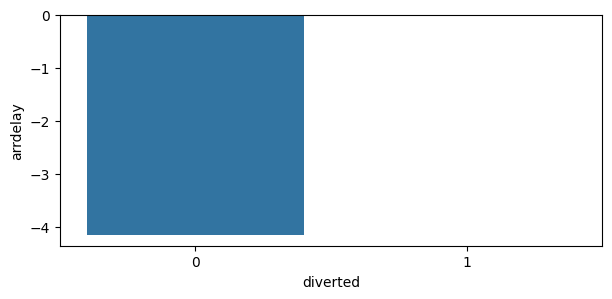

In [59]:
plt.figure(figsize=(7, 3))
sns.barplot(data=df, x='diverted', y='arrdelay', errorbar=None)
plt.show()

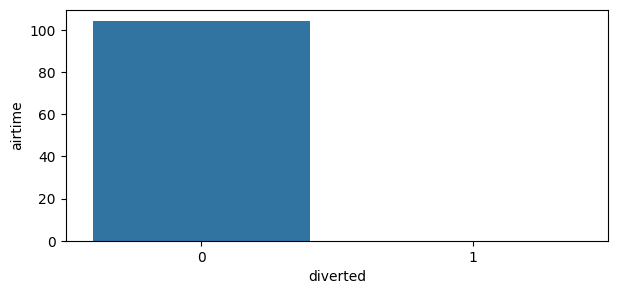

In [60]:
plt.figure(figsize=(7, 3))
sns.barplot(data=df, x='diverted', y='airtime', errorbar=None)
plt.show()

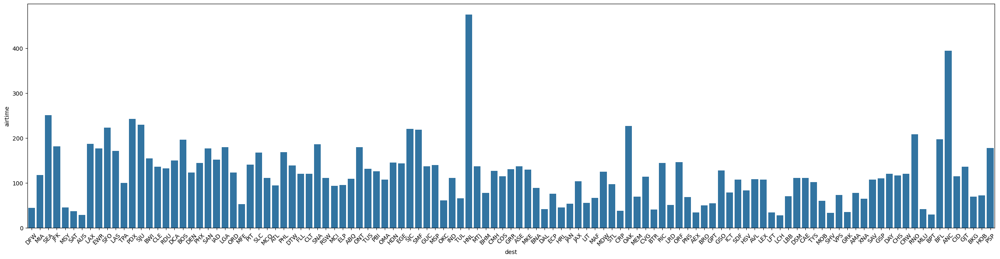

In [61]:
plt.figure(figsize=(30,7))
sns.barplot(data=df, x='dest', y='airtime', errorbar=None)
plt.xticks(rotation=45)
plt.show()

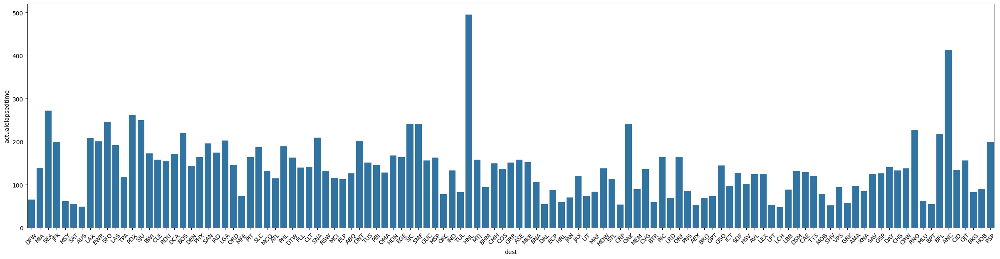

In [62]:
plt.figure(figsize=(30,7))
sns.barplot(data=df, x='dest', y='actualelapsedtime', errorbar=None)
plt.xticks(rotation=45)
plt.show()

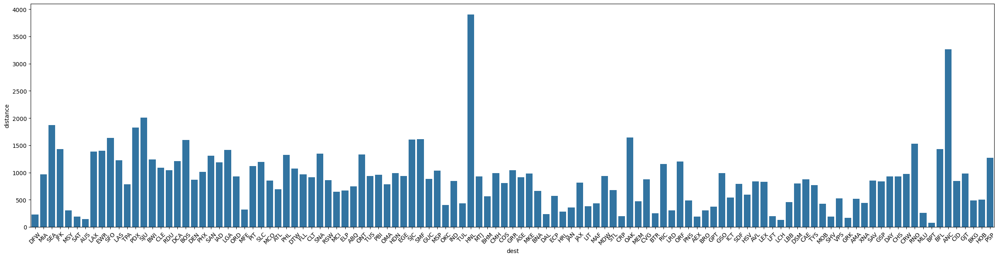

In [63]:
plt.figure(figsize=(30,7))
sns.barplot(data=df, x='dest', y='distance', errorbar=None)
plt.xticks(rotation=45)
plt.show()

<Axes: xlabel='uniquecarrier', ylabel='airtime'>

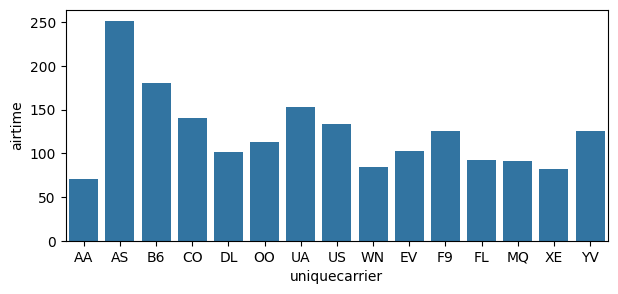

In [64]:
plt.figure(figsize=(7,3))
sns.barplot(data=df, x='uniquecarrier', y='airtime', errorbar=None)

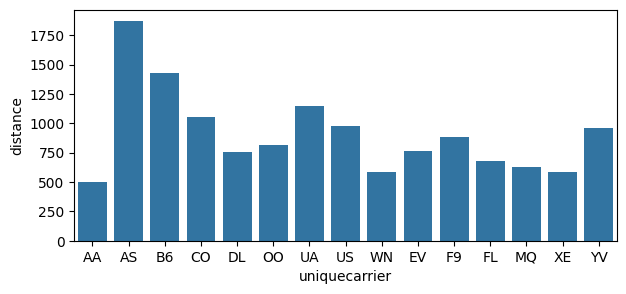

In [65]:
plt.figure(figsize=(7,3))
sns.barplot(data=df, x='uniquecarrier', y='distance', errorbar=None)
plt.show()

<Axes: xlabel='cancellationcode', ylabel='distance'>

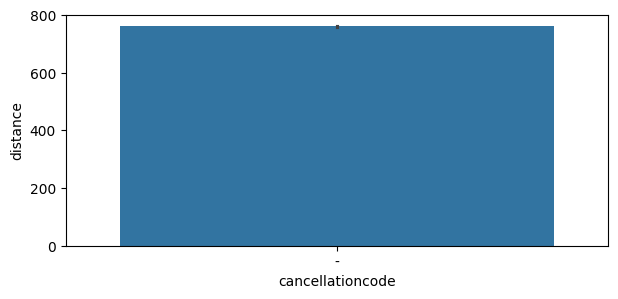

In [66]:
plt.figure(figsize=(7,3))
sns.barplot(data=df, x='cancellationcode', y='distance')

<Axes: xlabel='cancelled', ylabel='distance'>

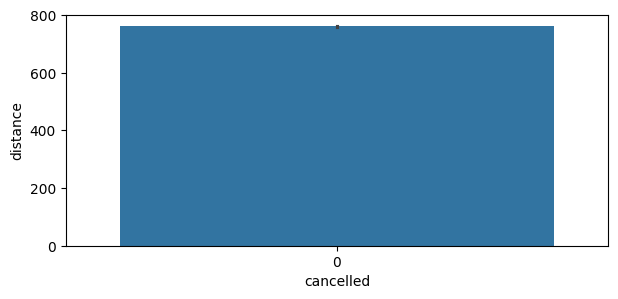

In [67]:
plt.figure(figsize=(7, 3))
sns.barplot(data=df, x='cancelled', y='distance')

<Axes: xlabel='diverted', ylabel='distance'>

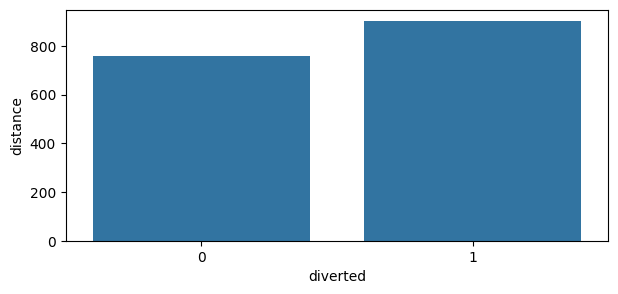

In [68]:
plt.figure(figsize=(7,3))
sns.barplot(data=df, x='diverted', y='distance', errorbar=None)

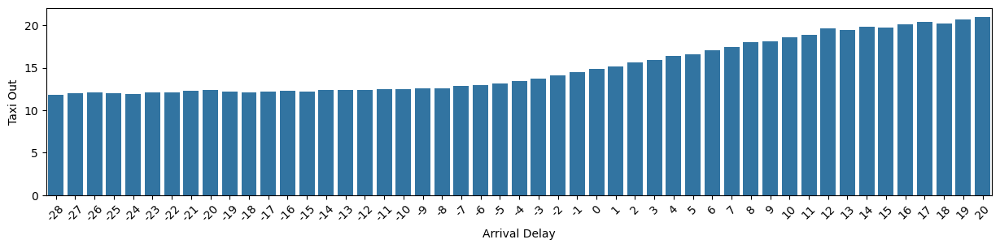

In [69]:
plt.figure(figsize=(15,3))
sns.barplot(data=df, x='arrdelay', y='taxiout', errorbar=None)
plt.xlabel('Arrival Delay')
plt.ylabel('Taxi Out')
plt.xticks(rotation=45)
plt.show()

In [70]:
#Notes
'''
- pesawat yang keluar dari tempat parkir pada bandara IAH membutuHkan waktu 2 kali lebih lama dibangdingkan di bandara HOU
- meskipun pesawat keluar dari tempat parkir lebih lama, hal tersebut tidak memiliki pengaruh terhadap jadwal keberangkatan tetapi memiliki pengaruh terhadap jadwal kedatangan
- bandara BPT, CID, DSM yang dijadikan destinasi memiliki penerbangan yang mengalami arrival delay
- bandara HNL, ANC merupakan destinasi bandara yang jauh karena waktu air time yang dibutuhkan menunjukkan waktu yang lama
- AS, B6, UA merupakan tipe pesawat yang memiliki waktu air time yang lama dan mampu menempuh jarak yang jauh
-
'''

'\n- pesawat yang keluar dari tempat parkir pada bandara IAH membutuHkan waktu 2 kali lebih lama dibangdingkan di bandara HOU\n- meskipun pesawat keluar dari tempat parkir lebih lama, hal tersebut tidak memiliki pengaruh terhadap jadwal keberangkatan tetapi memiliki pengaruh terhadap jadwal kedatangan\n- bandara BPT, CID, DSM yang dijadikan destinasi memiliki penerbangan yang mengalami arrival delay\n- bandara HNL, ANC merupakan destinasi bandara yang jauh karena waktu air time yang dibutuhkan menunjukkan waktu yang lama\n- AS, B6, UA merupakan tipe pesawat yang memiliki waktu air time yang lama dan mampu menempuh jarak yang jauh\n-\n'

**CATEGORICAL VS CATEGORICAL**

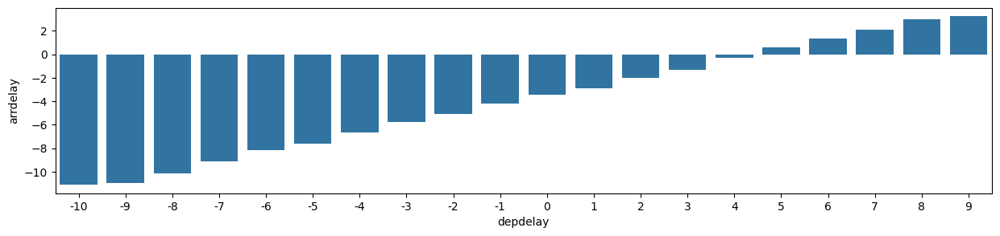

In [71]:
plt.figure(figsize=(15, 3))
sns.barplot(data=df, x='depdelay', y='arrdelay', errorbar=None)
plt.show()

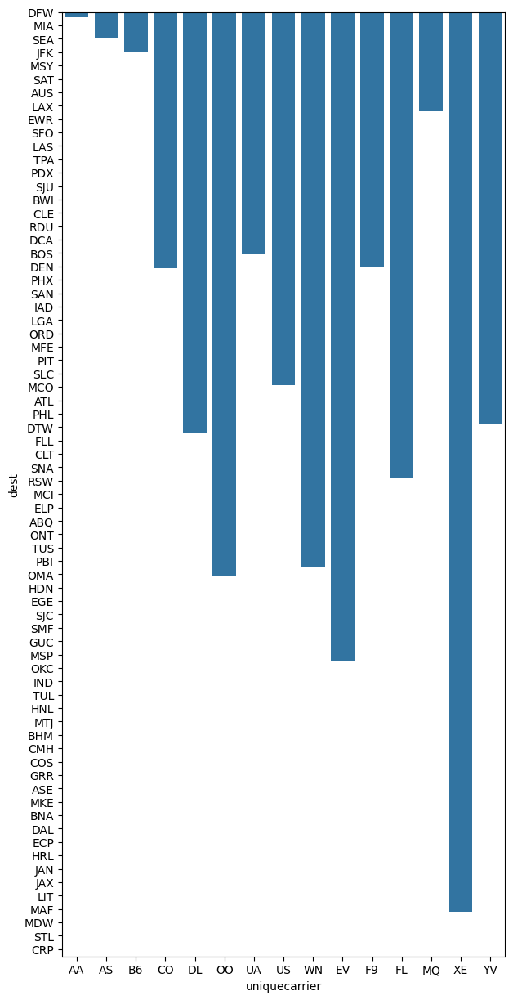

In [72]:
plt.figure(figsize=(7, 15))
sns.barplot(data=df, x='uniquecarrier', y='dest', errorbar=None)
plt.show()

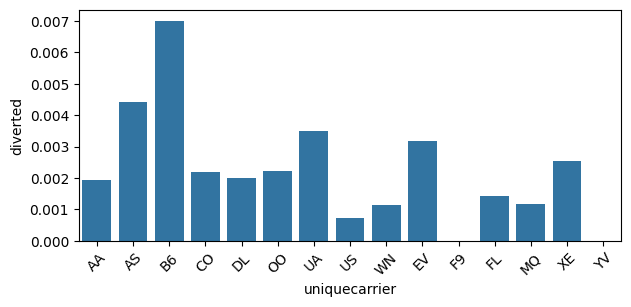

In [73]:
plt.figure(figsize=(7, 3))
sns.barplot(data=df, x='uniquecarrier', y='diverted', errorbar=None)
plt.xticks(rotation=45)
plt.show()

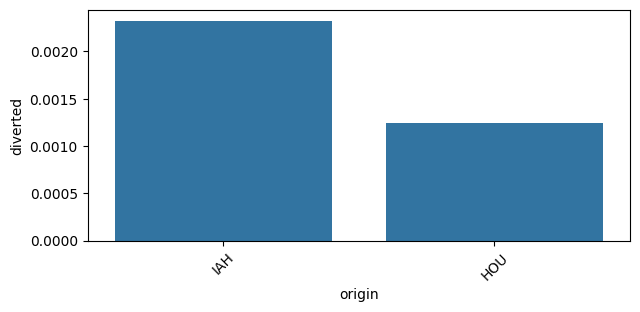

In [74]:
plt.figure(figsize=(7, 3))
sns.barplot(data=df, x='origin', y='diverted', errorbar=None)
plt.xticks(rotation=45)
plt.show()

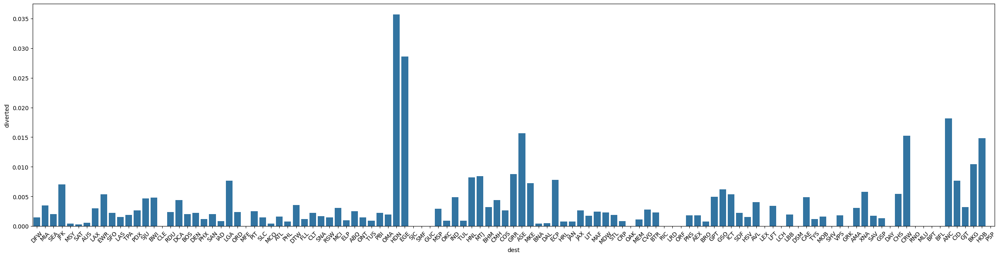

In [75]:
plt.figure(figsize=(30, 7))
sns.barplot(data=df, x='dest', y='diverted', errorbar=None)
plt.xticks(rotation=45)
plt.show()


In [76]:
#Notes

'''
- ketika pesawat telat berangkat maka akan berpengaruh terhadap kedatangan pesawat
- hal ini ditunjukkan jika pesawat telat berangkat 4-5 menit akan telat pada kedatangan yang mencapai waktu hingga 2 menit
- pesawat dengan jenis XE, EV, OO menerima jumlah destinasi yang banyak
- pesawat dengan jenis B6, US merupakan pesawat yang cukup sering mengalami diverted
- bandara keberangkatan IAH merupakan bandara yang pesawatnya paling banyak mengalami diverted
- destinasi HDN, EGE merupakan destinasi yang banyak terjadi diverted
'''

'\n- ketika pesawat telat berangkat maka akan berpengaruh terhadap kedatangan pesawat\n- hal ini ditunjukkan jika pesawat telat berangkat 4-5 menit akan telat pada kedatangan yang mencapai waktu hingga 2 menit\n- pesawat dengan jenis XE, EV, OO menerima jumlah destinasi yang banyak\n- pesawat dengan jenis B6, US merupakan pesawat yang cukup sering mengalami diverted\n- bandara keberangkatan IAH merupakan bandara yang pesawatnya paling banyak mengalami diverted\n- destinasi HDN, EGE merupakan destinasi yang banyak terjadi diverted\n'

###Multivariate EDA

In [77]:
#numeric_columns = taxiin, taxiout, distance, actualelapsedtime, airtime
#categorical_columns = diverted, uniquecarrier, origin, dest, depdelay, arrdelay

In [78]:
x_variable = "distance"
y_variable = "airtime"
color_variable = "diverted"  # A categorical variable for coloring

# Create a scatter plot with different colors
fig = px.scatter(df, x=x_variable, y=y_variable, color=color_variable,
                 title=f"Scatter Plot: {x_variable} vs {y_variable} (Colored by {color_variable})")

# Show the plot
fig.show()

In [79]:
x_variable = "distance"
y_variable = "actualelapsedtime"
color_variable = "depdelay"  # A categorical variable for coloring

# Create a scatter plot with different colors
fig = px.scatter(df, x=x_variable, y=y_variable, color=color_variable,
                 title=f"Scatter Plot: {x_variable} vs {y_variable} (Colored by {color_variable})")

# Show the plot
fig.show()

In [80]:
x_variable = "distance"
y_variable = "actualelapsedtime"
color_variable = "arrdelay"  # A categorical variable for coloring

# Create a scatter plot with different colors
fig = px.scatter(df, x=x_variable, y=y_variable, color=color_variable,
                 title=f"Scatter Plot: {x_variable} vs {y_variable} (Colored by {color_variable})")

# Show the plot
fig.show()

In [81]:
x_variable = "distance"
y_variable = "actualelapsedtime"
color_variable = "uniquecarrier"  # A categorical variable for coloring

# Create a scatter plot with different colors
fig = px.scatter(df, x=x_variable, y=y_variable, color=color_variable, hover_data='diverted',
                 title=f"Scatter Plot: {x_variable} vs {y_variable} (Colored by {color_variable})")

# Show the plot
fig.show()

In [82]:
x_variable = "distance"
y_variable = "arrdelay"
color_variable = "uniquecarrier"  # A categorical variable for coloring

# Create a scatter plot with different colors
fig = px.scatter(df, x=x_variable, y=y_variable, color=color_variable, hover_data='dest',
                 title=f"Scatter Plot: {x_variable} vs {y_variable} (Colored by {color_variable})")

# Show the plot
fig.show()

In [83]:
x_variable = "distance"
y_variable = "depdelay"
color_variable = "uniquecarrier"  # A categorical variable for coloring

# Create a scatter plot with different colors
fig = px.scatter(df, x=x_variable, y=y_variable, color=color_variable, hover_data='origin',
                 title=f"Scatter Plot: {x_variable} vs {y_variable} (Colored by {color_variable})")

# Show the plot
fig.show()

In [84]:
x_variable = "distance"
y_variable = "arrdelay"
color_variable = "dest"  # A categorical variable for coloring

# Create a scatter plot with different colors
fig = px.scatter(df, x=x_variable, y=y_variable, color=color_variable, hover_data='uniquecarrier',
                 title=f"Scatter Plot: {x_variable} vs {y_variable} (Colored by {color_variable})")

# Show the plot
fig.show()

In [85]:
x_variable = "distance"
y_variable = "arrdelay"
color_variable = "dest"  # A categorical variable for coloring

# Create a scatter plot with different colors
fig = px.scatter(df, x=x_variable, y=y_variable, color=color_variable,
                 title=f"Scatter Plot: {x_variable} vs {y_variable} (Colored by {color_variable})")

# Show the plot
fig.show()

In [86]:
x_variable = "distance"
y_variable = "depdelay"
color_variable = "origin"  # A categorical variable for coloring

# Create a scatter plot with different colors
fig = px.scatter(df, x=x_variable, y=y_variable, color=color_variable,
                 title=f"Scatter Plot: {x_variable} vs {y_variable} (Colored by {color_variable})")

# Show the plot
fig.show()

In [87]:
x_variable = "depdelay"
y_variable = "arrdelay"
color_variable = "dest"  # A categorical variable for coloring

# Create a scatter plot with different colors
fig = px.scatter(df, x=x_variable, y=y_variable, color=color_variable,
                 title=f"Scatter Plot: {x_variable} vs {y_variable} (Colored by {color_variable})")

# Show the plot
fig.show()

In [88]:
x_variable = "actualelapsedtime"
y_variable = "distance"
color_variable = "uniquecarrier"  # A categorical variable for coloring

# Create a scatter plot with different colors
fig = px.scatter(df, x=x_variable, y=y_variable, color=color_variable,
                 title=f"Scatter Plot: {x_variable} vs {y_variable} (Colored by {color_variable})")

# Show the plot
fig.show()

In [89]:
x_variable = "actualelapsedtime"
y_variable = "distance"
color_variable = "dest"  # A categorical variable for coloring

# Create a scatter plot with different colors
fig = px.scatter(df, x=x_variable, y=y_variable, color=color_variable,
                 title=f"Scatter Plot: {x_variable} vs {y_variable} (Colored by {color_variable})")

# Show the plot
fig.show()

In [90]:
x_variable = "airtime"
y_variable = "distance"
color_variable = "diverted"  # A categorical variable for coloring

# Create a scatter plot with different colors
fig = px.scatter(df, x=x_variable, y=y_variable, color=color_variable,
                 title=f"Scatter Plot: {x_variable} vs {y_variable} (Colored by {color_variable})")

# Show the plot
fig.show()

In [91]:
x_variable = "actualelapsedtime"
y_variable = "distance"
color_variable = "diverted"  # A categorical variable for coloring

# Create a scatter plot with different colors
fig = px.scatter(df, x=x_variable, y=y_variable, color=color_variable,
                 title=f"Scatter Plot: {x_variable} vs {y_variable} (Colored by {color_variable})")

# Show the plot
fig.show()

In [92]:
#Notes
'''
- pesawat dengan tipe CO merupakan pesawat yang mampu melakukan penerbangan dengan jarak jauh
- memang betul bahwa pesawat yang memiliki distance tetapi airtime-nya 0 merupakan penerbangan yang diverted
- penerbangan yang termasuk pada penerbangan diverted merupakan penerbangan yang tidak memiliki waktu selama penerbangan
'''

'\n- pesawat dengan tipe CO merupakan pesawat yang mampu melakukan penerbangan dengan jarak jauh\n- memang betul bahwa pesawat yang memiliki distance tetapi airtime-nya 0 merupakan penerbangan yang diverted\n- penerbangan yang termasuk pada penerbangan diverted merupakan penerbangan yang tidak memiliki waktu selama penerbangan\n'

#Solve the Problems

In [93]:
# Notes
'''
- Pesawat dengan kode XE menjadi pesawat dengan jumlah penerbangan terbanyak, diikuti oleh CO dan WN
- Penerbangan paling banyak terjadi dari Bandara IAH
- Dan tujuan dari penerbangan paling banyak menuju ke bandara DAL, MSY, DFW
- Dari penerbangan ini tidak terjadi adanya pembatalan tetapi terdapat beberapa penerbangan yang mengalami diverted
- rata-rata keberangkatan pesawat lebih awal 1 menit dari jadwal yang sudah ditentukan
- rata-rata kedatangan pesawat lebih awal sekitar 5 menit dari jadwal yang sudah ditentukan

- sebanyak 56% penerbangan yang terjadi sehari-hari memiliki jumlah diatas rata-rata
- distance dan air time memiliki hubungan yang positf, terdapat penerbangan yang tidak memiliki air time karena terdapat kemungkinan bahwa penerbangan tersebut diverted
- actual elapse time dengan air time memiliki hubungan yang positif
- actual elapse time dengan distance memiliki hubungan yang positif dan terdapat penerbangan yang tidak memiliki actual elapse time tetapi distance-nya cukup jauh, hal ini dapat terjadi
karena ada kemungkinan bahwa penerbangan tersebut termasuk diverted

- pesawat yang keluar dari tempat parkir pada bandara IAH membutuhkan waktu 2 kali lebih lama dibangdingkan di bandara HOU
- meskipun pesawat keluar dari tempat parkir lebih lama, hal tersebut tidak memiliki pengaruh terhadap jadwal keberangkatan tetapi memiliki pengaruh terhadap jadwal kedatangan
- bandara BPT, CID, DSM yang dijadikan destinasi memiliki penerbangan yang mengalami arrival delay
- bandara HNL, ANC merupakan destinasi bandara yang jauh karena waktu air time yang dibutuhkan menunjukkan waktu yang lama
- AS, B6, UA merupakan tipe pesawat yang memiliki waktu air time yang lama dan menempuh jarak yang jauh

- ketika pesawat telat berangkat maka akan berpengaruh terhadap kedatangan pesawat
- hal ini ditunjukkan jika pesawat telat berangkat 4-5 menit akan telat pada kedatangan yang mencapai waktu hingga 2 menit
- pesawat dengan jenis XE, EV, OO menerima jumlah destinasi yang banyak
- pesawat dengan jenis B6, US merupakan pesawat yang cukup sering mengalami diverted
- bandara keberangkatan IAH merupakan bandara yang pesawatnya paling banyak mengalami diverted
- destinasi HDN, EGE merupakan destinasi yang banyak terjadi diverted

- pesawat dengan tipe CO merupakan pesawat yang paling banyak melakukan penerbangan dengan jarak jauh
- memang betul bahwa pesawat yang memiliki distance tetapi airtime-nya 0 merupakan penerbangan yang diverted
- penerbangan yang termasuk pada penerbangan diverted merupakan penerbangan yang tidak memiliki waktu selama penerbangan
'''

'\n- Pesawat dengan kode XE menjadi pesawat dengan jumlah penerbangan terbanyak, diikuti oleh CO dan WN\n- Penerbangan paling banyak terjadi dari Bandara IAH\n- Dan tujuan dari penerbangan paling banyak menuju ke bandara DAL, MSY, DFW\n- Dari penerbangan ini tidak terjadi adanya pembatalan tetapi terdapat beberapa penerbangan yang mengalami diverted\n- rata-rata keberangkatan pesawat lebih awal 1 menit dari jadwal yang sudah ditentukan\n- rata-rata kedatangan pesawat lebih awal sekitar 5 menit dari jadwal yang sudah ditentukan\n\n- sebanyak 56% penerbangan yang terjadi sehari-hari memiliki jumlah diatas rata-rata\n- distance dan air time memiliki hubungan yang positf, terdapat penerbangan yang tidak memiliki air time karena terdapat kemungkinan bahwa penerbangan tersebut diverted\n- actual elapse time dengan air time memiliki hubungan yang positif\n- actual elapse time dengan distance memiliki hubungan yang positif dan terdapat penerbangan yang tidak memiliki actual elapse time tetapi 

###Problem 1

In [94]:
'''
Problem 1: Arrival Delays
Many flights experience significant arrival delays, leading to customer dissatisfaction and operational inefficiencies.
Question: What factors contribute most to arrival delays?

Hypothesis 1: Weather and Delays
Flights departing in winter months (e.g., December, January, February) are more likely to experience arrival delays due to adverse weather conditions.
'''

'\nProblem 1: Arrival Delays\nMany flights experience significant arrival delays, leading to customer dissatisfaction and operational inefficiencies.\nQuestion: What factors contribute most to arrival delays?\n\nHypothesis 1: Weather and Delays\nFlights departing in winter months (e.g., December, January, February) are more likely to experience arrival delays due to adverse weather conditions.\n'

In [95]:
round((df[df['arrdelay'] <= 0]['arrdelay'].count() / df['arrdelay'].count()) * 100,2)

#70.92% penerbangan tidak mengalami telat kedatangan
#29.08% penerbangan mengalami telat kedatangan

70.92

<Axes: xlabel='month', ylabel='arrdelay'>

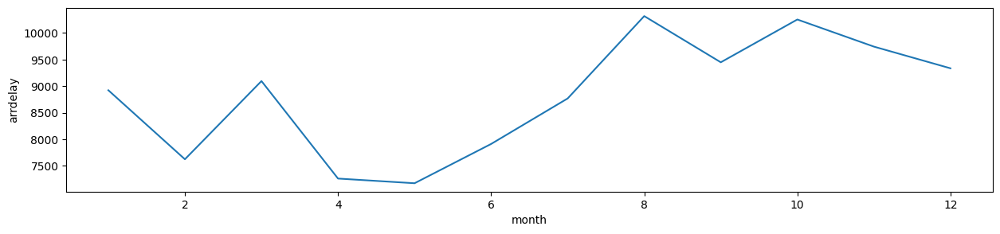

In [96]:
x = df[df['arrdelay'] <= 0].groupby('month')['arrdelay'].count().reset_index()
plt.figure(figsize=(15,3))
sns.lineplot(data=x, x='month', y='arrdelay')

<Axes: xlabel='month', ylabel='arrdelay'>

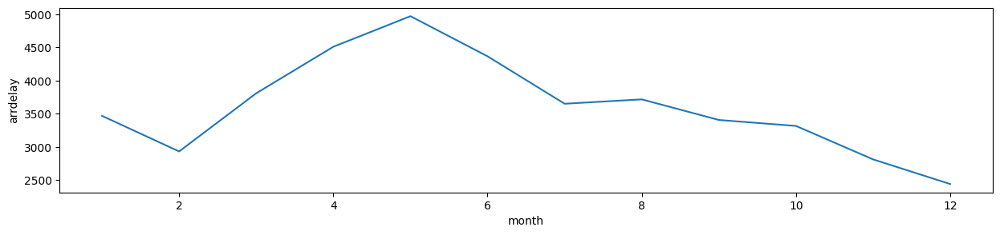

In [97]:
x = df[df['arrdelay'] > 0].groupby('month')['arrdelay'].count().reset_index()
plt.figure(figsize=(15,3))
sns.lineplot(data=x, x='month', y='arrdelay')

# pada bulan 3, 4, 5 terjadi peningkatan jumlah penerbangan yang mengalami telat kedatangan
# pada musim semi malah terjadi peningkatan jumlah penerbangan yang telat kedatangan, musim ini cenderung hangat tetapi sering turun hujan
# di bulan juni termasuk pada musim semi tetapi curah hujan bervariasi tiap kota

In [98]:
x  = df[(df['arrdelay'] > 0) & (df['month'] == 3) | (df['month'] == 4) | (df['month'] == 5)]
new_x = x.groupby(['origin', 'dest'])['arrdelay'].count().reset_index().sort_values(by='arrdelay',ascending=False)
new_x

,origin,dest,arrdelay
9,HOU,DAL,850
56,IAH,CLT,601
107,IAH,MSY,547
42,IAH,AUS,527
125,IAH,SAT,493
...,...,...,...
108,IAH,MTJ,9
39,IAH,ANC,7
40,IAH,ASE,4
4,HOU,BKG,4


In [99]:
x  = df[(df['arrdelay'] > 0) & (df['month'] == 3)]
new_x_3 = x.groupby(['origin', 'dest'])['arrdelay'].count().reset_index().sort_values(by='arrdelay',ascending=False)
new_x_3.head(10)

,origin,dest,arrdelay
8,HOU,DAL,108
119,IAH,SAT,101
51,IAH,CLT,100
101,IAH,MSY,98
39,IAH,AUS,91
92,IAH,MCI,90
60,IAH,DEN,64
54,IAH,CRP,63
104,IAH,OMA,63
38,IAH,ATL,57


In [100]:
x  = df[(df['arrdelay'] > 0) & (df['month'] == 4)]
new_x_4 = x.groupby(['origin', 'dest'])['arrdelay'].count().reset_index().sort_values(by='arrdelay',ascending=False)
new_x_4.head(10)

,origin,dest,arrdelay
38,IAH,AUS,124
114,IAH,SAT,108
79,IAH,LAX,107
106,IAH,PHX,106
53,IAH,CRP,97
88,IAH,MCI,94
8,HOU,DAL,92
97,IAH,MSY,90
34,IAH,ABQ,86
78,IAH,LAS,82


In [101]:
x  = df[(df['arrdelay'] > 0) & (df['month'] == 5)]
new_x_5 = x.groupby(['origin', 'dest'])['arrdelay'].count().reset_index().sort_values(by='arrdelay',ascending=False)
new_x_5.head(10)

,origin,dest,arrdelay
8,HOU,DAL,129
40,IAH,AUS,115
56,IAH,CRP,114
92,IAH,MCI,114
83,IAH,LAX,102
118,IAH,SAT,99
53,IAH,CLT,88
101,IAH,MSY,85
110,IAH,PHX,80
62,IAH,DEN,76


<Axes: xlabel='season', ylabel='numbers'>

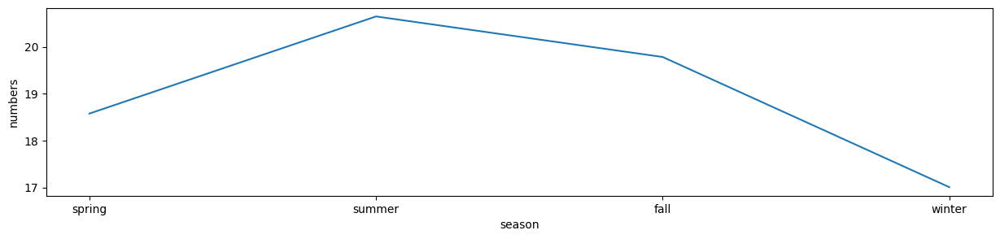

In [102]:
spring  = df[(df['arrdelay'] > 0) & (df['month'] == 3) | (df['month'] == 4) | (df['month'] == 5)]

summer  = df[(df['arrdelay'] > 0) & (df['month'] == 6) | (df['month'] == 7) | (df['month'] == 8)]

fall  = df[(df['arrdelay'] > 0) & (df['month'] == 9) | (df['month'] == 10) | (df['month'] == 11)]

winter  = df[(df['arrdelay'] > 0) & (df['month'] == 12) | (df['month'] == 1) | (df['month'] == 2)]

data = {'season' : ['spring', 'summer', 'fall', 'winter'],
        'numbers': [(spring['arrdelay'].count() / df['arrdelay'].count()) * 100
                    , (summer['arrdelay'].count() / df['arrdelay'].count()) * 100
                    , (fall['arrdelay'].count() / df['arrdelay'].count()) * 100
                    , (winter['arrdelay'].count() / df['arrdelay'].count()) * 100]}

season_data = pd.DataFrame(data)
plt.figure(figsize=(15,3))
sns.lineplot(data=season_data, x='season', y='numbers')

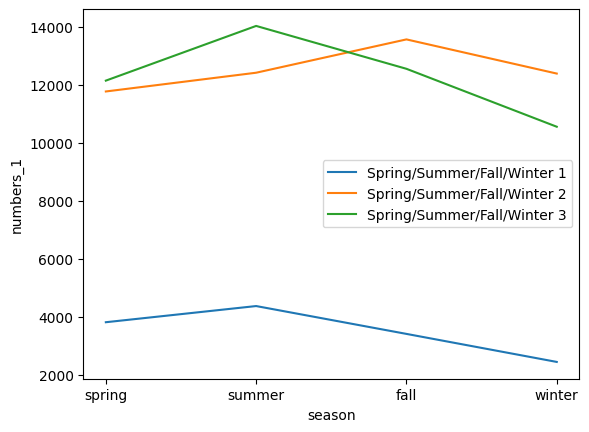

In [103]:
data = {'season' : ['spring', 'summer', 'fall', 'winter'],
        'numbers_1': [spring[spring['month'] == 3]['arrdelay'].count(), summer[summer['month']==6]['arrdelay'].count(), fall[fall['month'] == 9]['arrdelay'].count(), winter[winter['month']==12]['arrdelay'].count()],
        'numbers_2': [spring[spring['month'] == 4]['arrdelay'].count(), summer[summer['month']==7]['arrdelay'].count(), fall[fall['month'] == 10]['arrdelay'].count(), winter[winter['month']==1]['arrdelay'].count()],
        'numbers_3': [spring[spring['month'] == 5]['arrdelay'].count(), summer[summer['month']==8]['arrdelay'].count(), fall[fall['month'] == 11]['arrdelay'].count(), winter[winter['month']==2]['arrdelay'].count()]}

season_data = pd.DataFrame(data)
sns.lineplot(data=season_data, x='season', y='numbers_1', label='Spring/Summer/Fall/Winter 1')
sns.lineplot(data=season_data, x='season', y='numbers_2', label='Spring/Summer/Fall/Winter 2')
sns.lineplot(data=season_data, x='season', y='numbers_3', label='Spring/Summer/Fall/Winter 3')
plt.legend()
plt.show()


<Axes: xlabel='month', ylabel='arrdelay'>

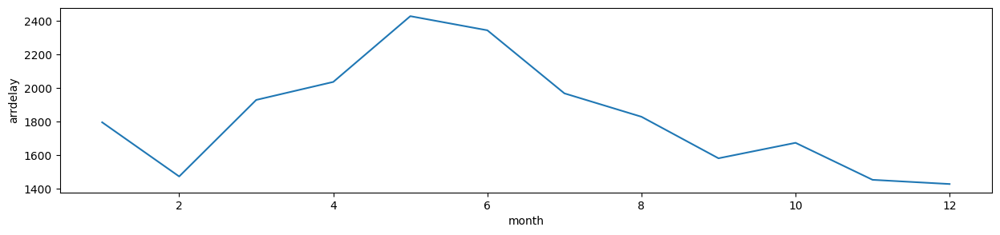

In [104]:
x = df[(df['arrdelay'] > 0) & (df['depdelay'] > 0)].groupby('month')['arrdelay'].count().reset_index()
plt.figure(figsize=(15,3))
sns.lineplot(data=x, x='month', y='arrdelay')

In [105]:
x  = df[(df['arrdelay'] > 0) & (df['depdelay'] > 0) | (df['month'] == 3) | (df['month'] == 4) | (df['month'] == 5)]
new_x = x.groupby(['origin', 'dest'])['arrdelay'].count().reset_index().sort_values(by='arrdelay',ascending=False)
new_x.head()

,origin,dest,arrdelay
9,HOU,DAL,1809
110,IAH,MSY,1044
57,IAH,CLT,1022
43,IAH,AUS,1011
129,IAH,SAT,937


<Axes: xlabel='season', ylabel='numbers'>

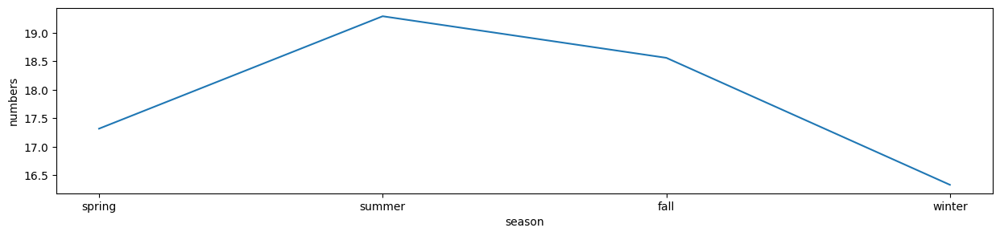

In [106]:
spring  = df[(df['arrdelay'] > 0) & (df['depdelay'] > 0) & (df['month'] == 3) | (df['month'] == 4) | (df['month'] == 5)]

summer  = df[(df['arrdelay'] > 0) & (df['depdelay'] > 0) & (df['month'] == 6) | (df['month'] == 7) | (df['month'] == 8)]

fall  = df[(df['arrdelay'] > 0) & (df['depdelay'] > 0) & (df['month'] == 9) | (df['month'] == 10) | (df['month'] == 11)]

winter  = df[(df['arrdelay'] > 0) & (df['depdelay'] > 0) & (df['month'] == 12) | (df['month'] == 1) | (df['month'] == 2)]

data = {'season' : ['spring', 'summer', 'fall', 'winter'],
        'numbers': [(spring['arrdelay'].count() / df['arrdelay'].count()) * 100
                    , (summer['arrdelay'].count() / df['arrdelay'].count()) * 100
                    , (fall['arrdelay'].count() / df['arrdelay'].count()) * 100
                    , (winter['arrdelay'].count() / df['arrdelay'].count()) * 100]}

season_data = pd.DataFrame(data)
plt.figure(figsize=(15,3))
sns.lineplot(data=season_data, x='season', y='numbers')

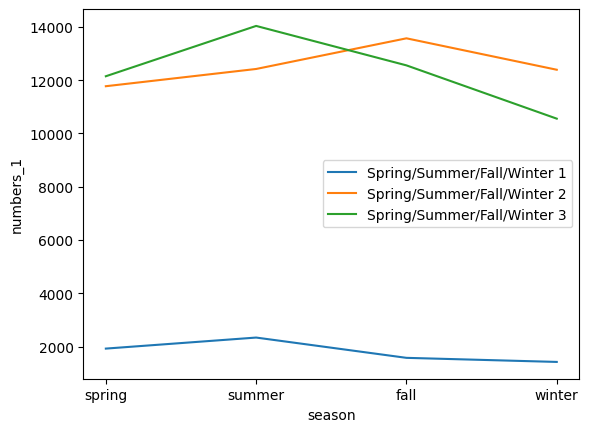

In [107]:
data = {'season' : ['spring', 'summer', 'fall', 'winter'],
        'numbers_1': [spring[spring['month'] == 3]['arrdelay'].count(), summer[summer['month']==6]['arrdelay'].count(), fall[fall['month'] == 9]['arrdelay'].count(), winter[winter['month']==12]['arrdelay'].count()],
        'numbers_2': [spring[spring['month'] == 4]['arrdelay'].count(), summer[summer['month']==7]['arrdelay'].count(), fall[fall['month'] == 10]['arrdelay'].count(), winter[winter['month']==1]['arrdelay'].count()],
        'numbers_3': [spring[spring['month'] == 5]['arrdelay'].count(), summer[summer['month']==8]['arrdelay'].count(), fall[fall['month'] == 11]['arrdelay'].count(), winter[winter['month']==2]['arrdelay'].count()]}

season_data = pd.DataFrame(data)
sns.lineplot(data=season_data, x='season', y='numbers_1', label='Spring/Summer/Fall/Winter 1')
sns.lineplot(data=season_data, x='season', y='numbers_2', label='Spring/Summer/Fall/Winter 2')
sns.lineplot(data=season_data, x='season', y='numbers_3', label='Spring/Summer/Fall/Winter 3')
plt.legend()
plt.show()

In [108]:
x = df[df['arrdelay'] > 0]
x[x['depdelay'] > 0]['depdelay'].count() / x['depdelay'].count() * 100

50.55646443466439

###Problems 2

In [109]:
'''
Problem 2: Impact of Cancellations and Diversions
Flights being diverted disrupt schedules and cause economic losses.
Question: What patterns or factors increase the likelihood of flight diversions?

Hypothesis 2: Cancellation Factors
Flights with longer scheduled departure times (e.g., late-night flights) are more likely to be diverted due to operational challenges.
'''

'\nProblem 2: Impact of Cancellations and Diversions\nFlights being diverted disrupt schedules and cause economic losses.\nQuestion: What patterns or factors increase the likelihood of flight diversions?\n\nHypothesis 2: Cancellation Factors\nFlights with longer scheduled departure times (e.g., late-night flights) are more likely to be diverted due to operational challenges.\n'

<Axes: xlabel='diverted', ylabel='count'>

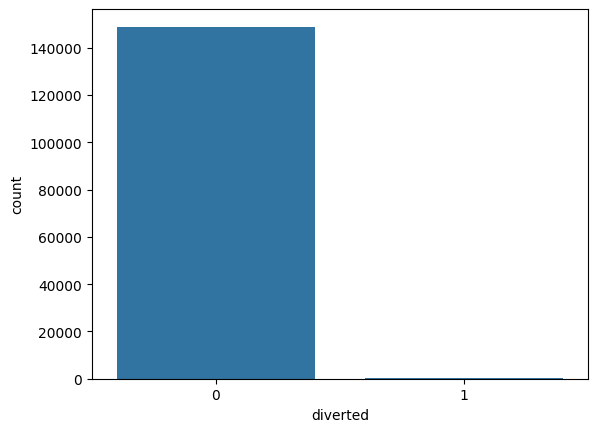

In [110]:
sns.countplot(data=df, x='diverted')

In [111]:
df[df['diverted'] == 1]['diverted'].count() / df['diverted'].count() * 100

#20% penerbangan mengalami diverted (312)

0.2090452261306533

<Axes: xlabel='origin', ylabel='count'>

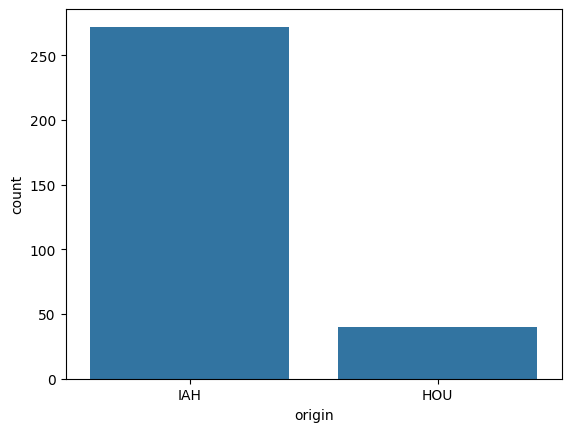

In [112]:
x = df[df['diverted'] == 1]
sns.countplot(data=x, x='origin')

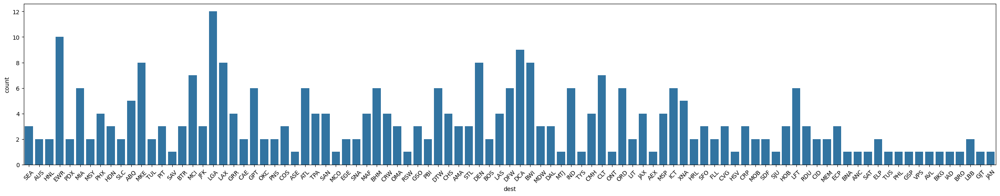

In [113]:
plt.figure(figsize=(30,5))
sns.countplot(data=x, x='dest')
plt.xticks(rotation=45)
plt.show()

In [114]:
new_x = x.groupby(['origin','dest'])['date'].count().reset_index().sort_values(by='date',ascending=False)
pd.merge(new_x[new_x['origin'] == 'IAH'], new_x[new_x['origin'] == 'HOU'], left_on='dest', right_on='dest')[['origin_x', 'dest', 'date_x', 'origin_y', 'dest', 'date_y']]

,origin_x,dest,date_x,origin_y,dest,date_y
0,IAH,EWR,9,HOU,EWR,1
1,IAH,BWI,7,HOU,BWI,1
2,IAH,DEN,6,HOU,DEN,2
3,IAH,BHM,5,HOU,BHM,1
4,IAH,DFW,5,HOU,DFW,1
5,IAH,ABQ,4,HOU,ABQ,1
6,IAH,LAX,4,HOU,LAX,4
7,IAH,SAN,3,HOU,SAN,1
8,IAH,PHX,3,HOU,PHX,1
9,IAH,ATL,3,HOU,ATL,3


<Axes: xlabel='diverted', ylabel='distance'>

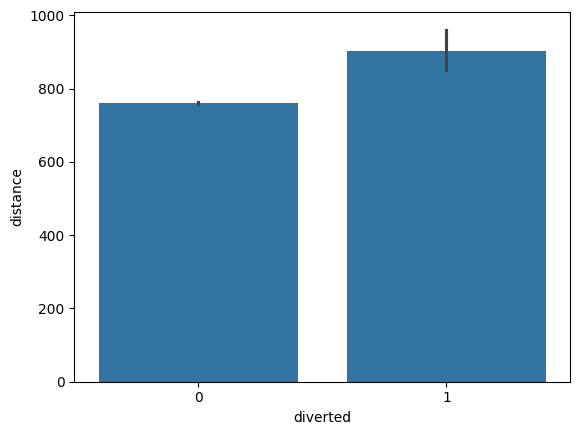

In [115]:
sns.barplot(data=df, x='diverted', y='distance')

In [116]:
x['deptime'] = x['deptime'].apply(lambda x: x.strftime('%H:%M'))
x['deptime'] = pd.to_datetime(x['deptime'], format='%H:%M')
x['new_deptime'] = x['deptime'].dt.floor('H')
x['new_deptime'] = x['new_deptime'].dt.strftime('%H:%M')

x['arrtime'] = x['arrtime'].apply(lambda x: x.strftime('%H:%M'))
x['arrtime'] = pd.to_datetime(x['arrtime'], format='%H:%M')
x['new_arrtime'] = x['arrtime'].dt.floor('H')
x['new_arrtime'] = x['new_arrtime'].dt.strftime('%H:%M')
x.head()

,date,uniquecarrier,flightnum,tailnum,taxiout,deptime,depdelay,arrtime,arrdelay,taxiin,...,airtime,cancelled,cancellationcode,diverted,year,month,dayofmonth,dayofweek,new_deptime,new_arrtime
283,2011-01-11,AS,731,N626AS,18,1900-01-01 18:20:00,-5,1900-01-01 00:12:00,0,4,...,0,0,-,1,2011,1,11,2,18:00,00:00
885,2011-01-29,CO,1541,N19638,16,1900-01-01 14:34:00,4,1900-01-01 17:30:00,0,5,...,0,0,-,1,2011,1,29,6,14:00,17:00
2884,2011-01-18,CO,1,N66057,17,1900-01-01 09:27:00,2,1900-01-01 15:46:00,0,4,...,0,0,-,1,2011,1,18,2,09:00,15:00
4078,2011-01-12,CO,210,N35407,15,1900-01-01 15:58:00,8,1900-01-01 23:31:00,0,11,...,0,0,-,1,2011,1,12,3,15:00,23:00
4441,2011-01-10,CO,209,N15712,12,1900-01-01 21:32:00,9,1900-01-01 01:12:00,0,5,...,0,0,-,1,2011,1,10,1,21:00,01:00


<Axes: xlabel='new_deptime', ylabel='count'>

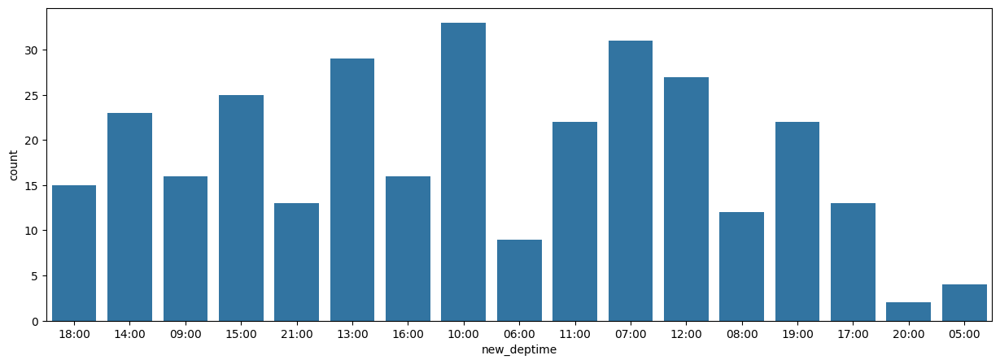

In [117]:
plt.figure(figsize=(15,5))
sns.countplot(data=x, x='new_deptime')
#waktu yang paling sering terjadi diverted adalah 10.00, 07.00, 13.00, 12.00

In [118]:
x.describe()

,date,flightnum,taxiout,deptime,depdelay,arrtime,arrdelay,taxiin,distance,actualelapsedtime,airtime,year,month,dayofmonth,dayofweek
count,312,312.000000,312.000000,312,312.000000,312,312.0,312.000000,312.000000,312.0,312.0,312.0,312.000000,312.000000,312.000000
mean,2011-07-04 01:09:13.846153728,2147.006410,15.423077,1900-01-01 13:16:14.230769152,-0.086538,1900-01-01 16:24:36.923076864,0.0,5.826923,903.772436,0.0,0.0,2011.0,6.583333,16.173077,3.964744
min,2011-01-03 00:00:00,1.000000,5.000000,1900-01-01 05:50:00,-10.000000,1900-01-01 00:02:00,0.0,2.000000,140.000000,0.0,0.0,2011.0,1.000000,1.000000,1.000000
25%,2011-04-19 18:00:00,1146.750000,11.000000,1900-01-01 10:17:30,-3.000000,1900-01-01 13:30:45,0.0,4.000000,562.000000,0.0,0.0,2011.0,4.000000,9.000000,2.000000
50%,2011-06-30 00:00:00,2026.500000,15.000000,1900-01-01 13:04:00,-1.000000,1900-01-01 17:30:30,0.0,5.000000,913.000000,0.0,0.0,2011.0,6.500000,16.000000,4.000000
75%,2011-09-16 00:00:00,2764.500000,19.000000,1900-01-01 16:19:45,3.000000,1900-01-01 20:34:30,0.0,7.000000,1191.250000,0.0,0.0,2011.0,9.000000,23.000000,6.000000
max,2011-12-31 00:00:00,6726.000000,30.000000,1900-01-01 21:55:00,9.000000,1900-01-01 23:59:00,0.0,11.000000,3904.000000,0.0,0.0,2011.0,12.000000,31.000000,7.000000
std,NaN,1385.693286,5.781708,NaN,4.158694,NaN,0.0,2.206869,474.834190,0.0,0.0,0.0,3.199595,8.442858,1.987592


<Axes: xlabel='month', ylabel='date'>

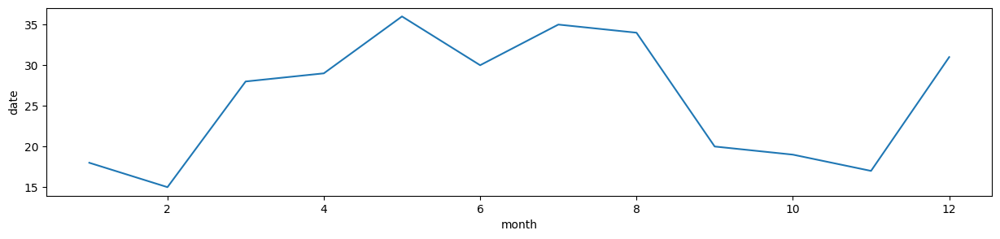

In [119]:
plt.figure(figsize=(15,3))
sns.lineplot(data= x.groupby('month')['date'].count().reset_index(), x='month', y='date')

#pada bulan 3,4,5 atau musim semi merupakan musim dimana jumlah penerbangan yang diverted memiliki jumlah yang tinggi
#pada bulan ke-2 dari musim panas mengalami peningkatan
#pada bulan ke-1 dari musim dingin mengalami pengingkatan
#pada musim gugur terjadi penurunan yang signifikan


###Problems 3

In [119]:
'''
Problem 3: Seasonal Demand and Performance
Flight performance may vary significantly based on the time of year (e.g., holidays or weather).
Question: How does seasonality (month or day of the week) affect delays?

Hypothesis 3: Day of Week and Delays
Flights on weekends (Saturday and Sunday) experience fewer delays compared to weekdays due to lighter air traffic.
'''

<Axes: xlabel='month', ylabel='date'>

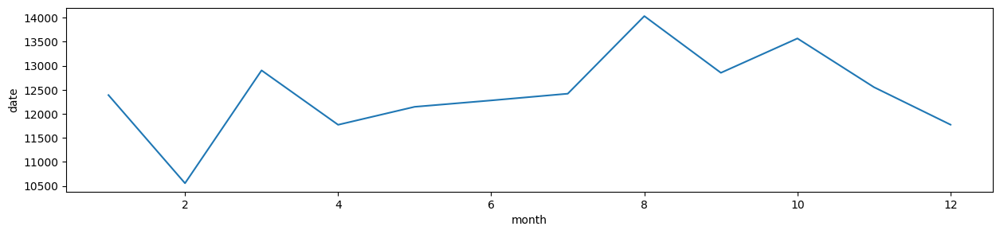

In [126]:
#total flight setiap bulan
plt.figure(figsize=(15,3))
sns.lineplot(data=df.groupby('month')['date'].count().reset_index(), x='month', y='date')

In [138]:
x = df.copy()
x['day_of_date'] = df['date'].dt.day_name()
weekend_flight = x[(x['day_of_date'] == 'Saturday') | (x['day_of_date'] == 'Sunday')]
weekdays_flight = x[~(x['day_of_date'] == 'Saturday') & ~(x['day_of_date'] == 'Sunday')]


array([[<Axes: title={'center': 'depdelay'}>,
        <Axes: title={'center': 'arrdelay'}>],
       [<Axes: title={'center': 'distance'}>,
        <Axes: title={'center': 'actualelapsedtime'}>],
       [<Axes: title={'center': 'taxiout'}>,
        <Axes: title={'center': 'taxiin'}>]], dtype=object)

<Figure size 2000x500 with 0 Axes>

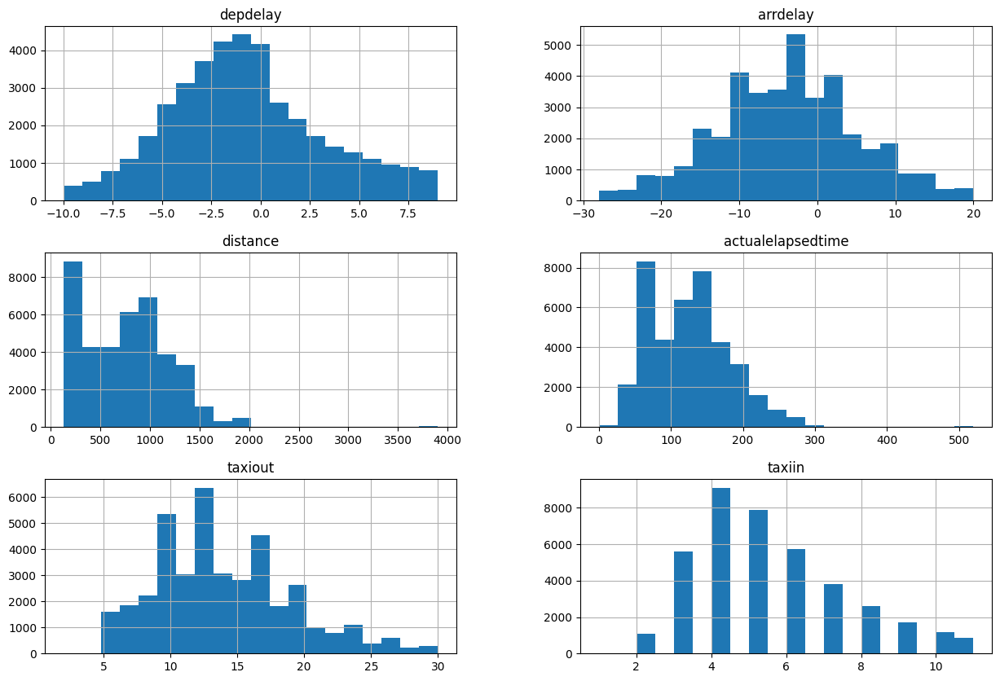

In [142]:
weekend_flight[['depdelay','arrdelay','distance','actualelapsedtime','taxiout','taxiin']].hist(bins=20, figsize=(15,10))
#rata-rata keberangkatan pesawat saat weekend tidak mengalami delay, begitu juga dengan kedatangan pesawat

array([[<Axes: title={'center': 'depdelay'}>,
        <Axes: title={'center': 'arrdelay'}>],
       [<Axes: title={'center': 'distance'}>,
        <Axes: title={'center': 'actualelapsedtime'}>],
       [<Axes: title={'center': 'taxiout'}>,
        <Axes: title={'center': 'taxiin'}>]], dtype=object)

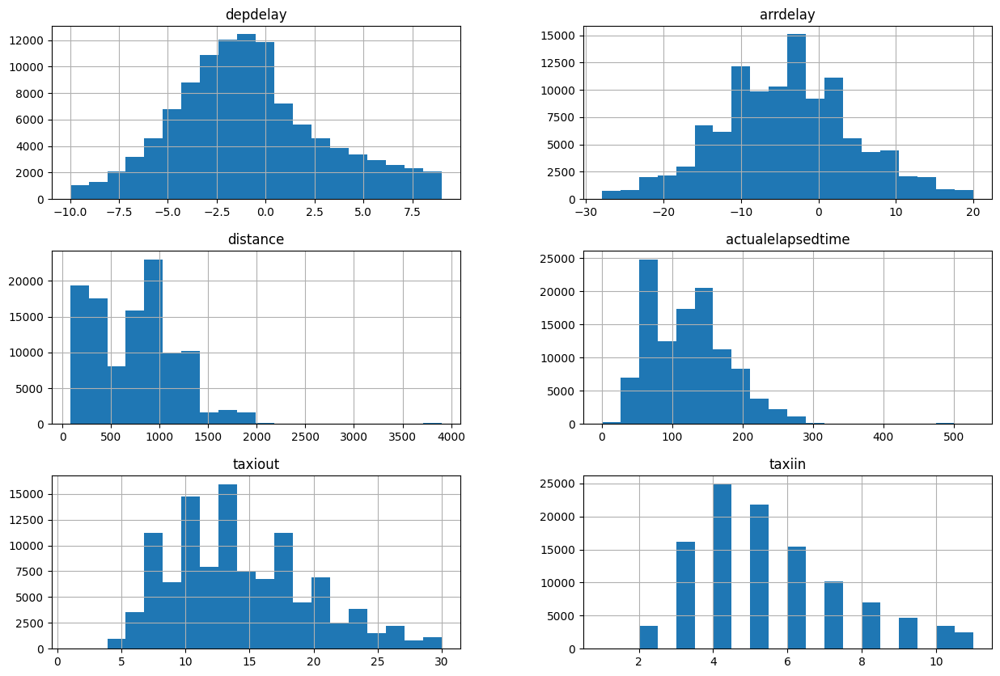

In [143]:
weekdays_flight[['depdelay','arrdelay','distance','actualelapsedtime','taxiout','taxiin']].hist(bins=20, figsize=(15,10))
#rata-rata keberangkatan pesawat saat weekdays tidak mengalami delay, begitu juga dengan kedatangan pesawat

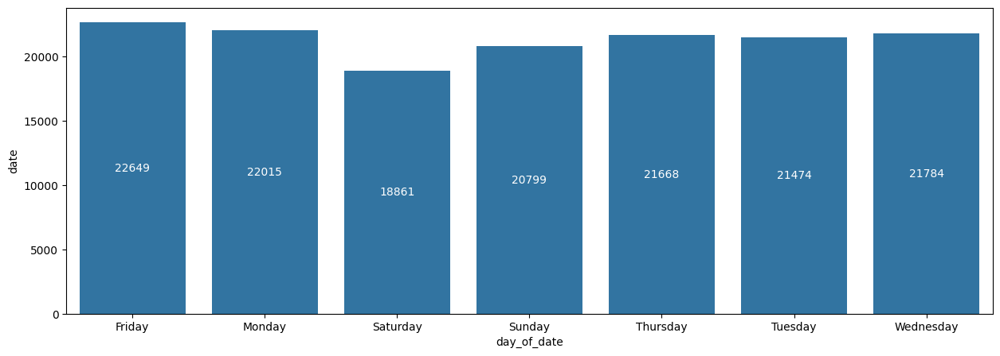

In [164]:
plt.figure(figsize=(15,5))
ax = sns.barplot(data=x.groupby('day_of_date')['date'].count().reset_index(),x='day_of_date', y='date')
for bar in ax.patches:
    height = bar.get_height()
    ax.annotate(f'{int(height)}',
                xy=(bar.get_x() + bar.get_width() / 2, height / 2),  # Position label at the middle of the bar
                ha='center', va='center', color='white', fontsize=10)
#weekend memiliki jumlah penerbangan yang lebih rendah dibandingkan dengan hari di weekdays

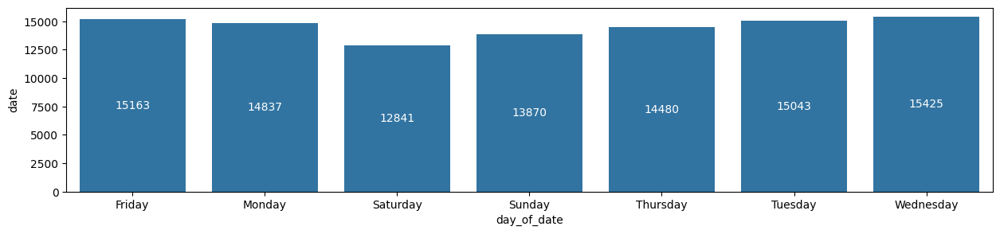

In [162]:
plt.figure(figsize=(15,3))
ax = sns.barplot(data=x[x['depdelay'] <=0].groupby('day_of_date')['date'].count().reset_index(),x='day_of_date', y='date')

for bar in ax.patches:
    height = bar.get_height()
    ax.annotate(f'{int(height)}',
                xy=(bar.get_x() + bar.get_width() / 2, height / 2),  # Position label at the middle of the bar
                ha='center', va='center', color='white', fontsize=10)
#hari yang ada di weekend memiliki jumlah yang kecil keberangkatan yang tidak delay jika dibandingkan dengan hari di weekdays

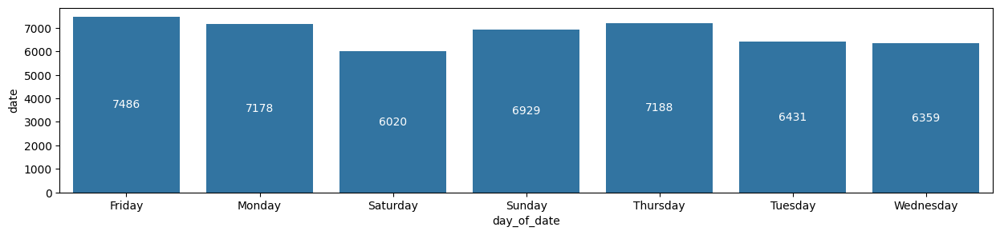

In [161]:
plt.figure(figsize=(15,3))
ax = sns.barplot(data=x[x['depdelay'] > 0].groupby('day_of_date')['date'].count().reset_index(),x='day_of_date', y='date')

for bar in ax.patches:
    height = bar.get_height()
    ax.annotate(f'{int(height)}',
                xy=(bar.get_x() + bar.get_width() / 2, height / 2),  # Position label at the middle of the bar
                ha='center', va='center', color='white', fontsize=10)
#hari Sabtu memiliki jumlah yang rendah pada departure delay dibandingkan dengan hari lainnya
#hari Jumat memiliki jumlah yang tinggi dari semua hari

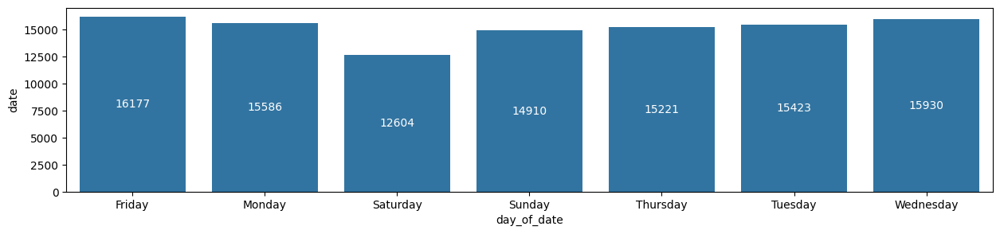

In [160]:
plt.figure(figsize=(15,3))
ax = sns.barplot(data=x[x['arrdelay'] <=0 ].groupby('day_of_date')['date'].count().reset_index(),x='day_of_date', y='date')

for bar in ax.patches:
    height = bar.get_height()
    ax.annotate(f'{int(height)}',
                xy=(bar.get_x() + bar.get_width() / 2, height / 2),  # Position label at the middle of the bar
                ha='center', va='center', color='white', fontsize=10)

#hari sabtu memiliki jumlah kedatangan penerbangan yang tidak delay lebih sedikit dibandingkan dengan hari minggu.


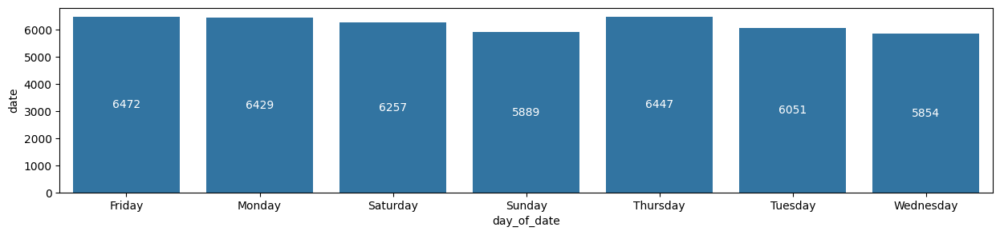

In [163]:
plt.figure(figsize=(15, 3))
ax = sns.barplot(data=x[x['arrdelay'] > 0 ].groupby('day_of_date')['date'].count().reset_index(), x='day_of_date', y='date')

for bar in ax.patches:
    height = bar.get_height()
    ax.annotate(f'{int(height)}',
                xy=(bar.get_x() + bar.get_width() / 2, height / 2),  # Position label at the middle of the bar
                ha='center', va='center', color='white', fontsize=10)

#hari sabtu memiliki jumlah arrival delay lebih banyak dibandingkan dengan hari minggu dan hari yang ada di weekdays yakni selasa dan rabu
#hari Jumat memiliki jumlah yang tinggi dari semua hari

<Axes: xlabel='month', ylabel='date'>

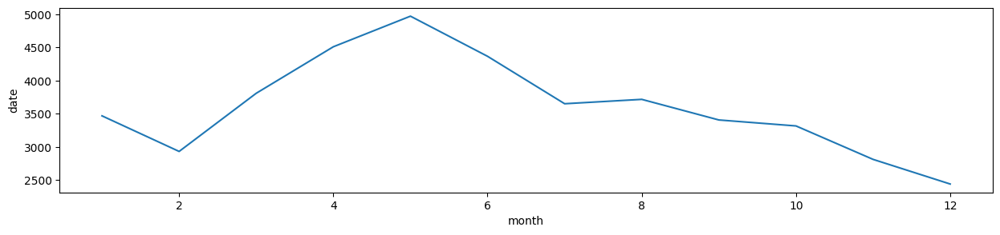

In [168]:
plt.figure(figsize=(15,3))
sns.lineplot(data=x[x['arrdelay'] > 0].groupby('month')['date'].count().reset_index(),x='month',y='date')

#pada bulan 3,4,5 merupakan bulan yang mengalami peningkatan jumlah delay kedatangan

<Axes: xlabel='month', ylabel='date'>

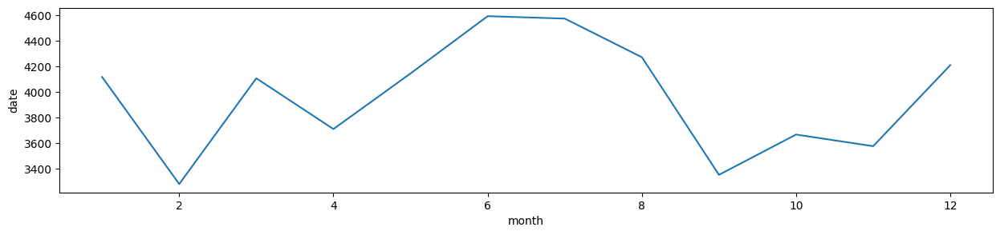

In [169]:
plt.figure(figsize=(15,3))
sns.lineplot(data=x[x['depdelay'] > 0].groupby('month')['date'].count().reset_index(),x='month',y='date')
#jumlah keberangkatan yang delay untuk setiap bulannya mengalami fluktuasi
#pada bulan 3,5,6,10,12 merupakan bulan yang mengalami peningkatan jumlah delay kedatangan


###Problems 4

In [ ]:
'''
Problem 4: Distance vs. Delays
Longer flights might have different delay patterns compared to shorter flights.
Question: Is there a relationship between flight distance and the likelihood or magnitude of delays?

Hypothesis 4: Short Flights and Delays
Short-distance flights (e.g., <500 miles) are less likely to experience significant delays compared to long-distance flights.
'''

(array([0.5, 1.5, 2.5, 3.5, 4.5, 5.5, 6.5]),
 [Text(0.5, 0, 'taxiout'),
  Text(1.5, 0, 'depdelay'),
  Text(2.5, 0, 'arrdelay'),
  Text(3.5, 0, 'taxiin'),
  Text(4.5, 0, 'distance'),
  Text(5.5, 0, 'actualelapsedtime'),
  Text(6.5, 0, 'airtime')])

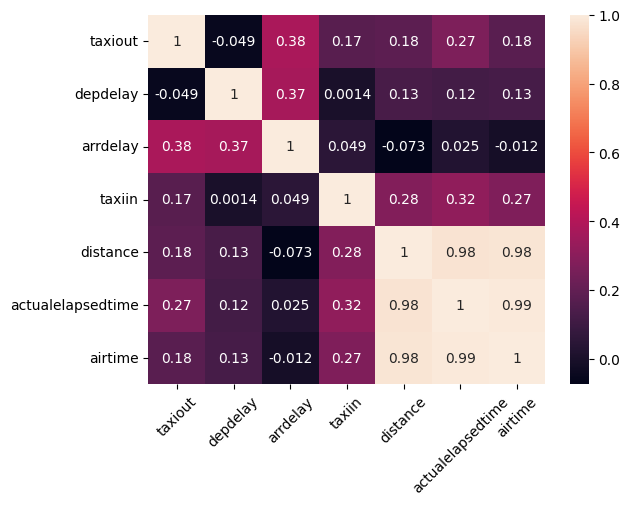

In [174]:
numerical_columns = df[['taxiout', 'depdelay', 'arrdelay', 'taxiin','distance', 'actualelapsedtime', 'airtime']]
sns.heatmap(numerical_columns.corr(), annot=True)
plt.xticks(rotation=45)

#distance dan departure delay memiliki hubungan yang lemah tetapi hubungannya positif
#distance dan arrival delay memiliki hubungan yang lemah dan negafif

In [187]:
distance_under_500= df[df['distance'] <= 500]
distance_under_500['distance'].count() / df['distance'].count() * 100

34.97822445561139

In [188]:
distance_under_500[distance_under_500['depdelay'] > 0]['depdelay'].count() / distance_under_500['depdelay'].count() * 100

27.547169811320753

In [189]:
distance_under_500[distance_under_500['arrdelay'] > 0]['arrdelay'].count() / distance_under_500['arrdelay'].count() * 100

28.443635667081697

In [190]:
distance_over_500= df[df['distance'] > 500]
distance_over_500['distance'].count() / df['distance'].count() * 100

65.0217755443886

In [191]:
distance_over_500[distance_over_500['depdelay'] > 0]['depdelay'].count() / distance_over_500['depdelay'].count() * 100

34.22123757019939

In [192]:
distance_over_500[distance_over_500['arrdelay'] > 0]['arrdelay'].count() / distance_over_500['arrdelay'].count() * 100

29.41934154258334

# Findings and Actionable Insight

###Problems 1

In [120]:
#Findings
'''
Pesawat yang paling sering mengalami arrival delay ternyata lebih banyak terjadi di musim semi, bukan di musim dingin seperti yang umum diasumsikan.
Salah satu penyebab utamanya adalah cuaca menantang yang kerap dihadapi pada musim ini, baik saat keberangkatan maupun di tengah perjalanan.
Bandara tujuan dengan tingkat arrival delay tertinggi meliputi DAL, CLT, dan MSY, sedangkan IAH menjadi bandara keberangkatan yang paling sering memulai perjalanan dengan keterlambatan.
Selain itu, departure delay terbukti menjadi kontributor utama, menyumbang hingga 50% dari total arrival delay, dengan cuaca sebagai faktor penyebab utama.
Fakta ini menggarisbawahi bahwa musim semi adalah periode yang lebih rentan terhadap arrival delay dibandingkan musim dingin, yang sebelumnya dianggap sebagai penyebab utama.
'''

#Insight
'''
- Memberikan pemberitahuan proaktif tentang potensi keterlambatan akibat cuaca kepada penumpang dapat meningkatkan kepuasan pelanggan.
- Meningkatkan kesiapan dalam mengatur kembali jadwal penerbangan dan meningkatkan koordinasi dengan bandara akan mempercepat pemulihan jadwal penerbangan.
- Maskapai dapat melakukan analisis lebih mendalam untuk memprediksi cuaca ekstrem dan mencari solusi pencegahan yang lebih baik di setiap musim terutama musim semi.
- Menyediakan informasi cuaca secara real-time kepada pilot dan staf ground crew dapat membantu dalam perencanaan penerbangan yang lebih efisien dan mengurangi risiko arrival delay.
'''

'\n- Memberikan pemberitahuan proaktif tentang potensi keterlambatan akibat cuaca kepada penumpang dapat meningkatkan kepuasan pelanggan.\n- Meningkatkan kesiapan dalam mengatur kembali jadwal penerbangan dan meningkatkan koordinasi dengan bandara akan mempercepat pemulihan jadwal penerbangan.\n- Maskapai dapat melakukan analisis lebih mendalam untuk memprediksi cuaca ekstrem dan mencari solusi pencegahan yang lebih baik di setiap musim terutama musim semi.\n- Menyediakan informasi cuaca secara real-time kepada pilot dan staf ground crew dapat membantu dalam perencanaan penerbangan yang lebih efisien dan mengurangi risiko arrival delay.\n'

###Problems 2

In [121]:
#Findings
'''
Penerbangan yang dialihkan (diverted) seringkali dipengaruhi oleh faktor cuaca, yang menjadi penyebab utama terjadinya perubahan rute.
Menariknya, selama musim semi, jumlah penerbangan yang dialihkan meningkat setiap bulannya.
Bandara IAH tercatat sebagai lokasi dengan frekuensi penerbangan diverted terbanyak.
Waktu yang paling sering mengalami penerbangan dialihkan adalah pada jam 10:00, 07:00, 13:00, dan 12:00.
Meskipun ada dugaan bahwa lamanya waktu perjalanan yang dijadwalkan menjadi penyebab, hipotesis tersebut terbantahkan.
Ternyata, faktor cuaca yang tidak terduga justru menjadi penyebab utama penerbangan diverted, tanpa pengaruh signifikan dari durasi perjalanan atau jarak destinasi.
'''

#Insigth
'''
- Mengingat cuaca menjadi faktor utama penyebab penerbangan diverted, pihak maskapai dan bandara perlu meningkatkan sistem pemantauan cuaca, terutama saat musim semi
- Penerbangan diverted lebih sering terjadi pada jam 07:00, 10:00, 12:00, dan 13:00, maskapai bisa mempertimbangkan untuk menjadwalkan penerbangan terutama di musim semi
- Meskipun durasi perjalanan atau jarak tidak berpengaruh langsung terhadap penerbangan diverted, perhatian lebih harus diberikan pada kenyamanan dan keselamatan penumpang
'''

'\n- Mengingat cuaca menjadi faktor utama penyebab penerbangan diverted, pihak maskapai dan bandara perlu meningkatkan sistem pemantauan cuaca, terutama saat musim semi\n- Penerbangan diverted lebih sering terjadi pada jam 07:00, 10:00, 12:00, dan 13:00, maskapai bisa mempertimbangkan untuk menjadwalkan penerbangan terutama di musim semi\n- Meskipun durasi perjalanan atau jarak tidak berpengaruh langsung terhadap penerbangan diverted, perhatian lebih harus diberikan pada kenyamanan dan keselamatan penumpang\n'

###Problems 3

In [ ]:
#Findings
'''
Selama bulan Mei hingga Agustus, total penerbangan mengalami peningkatan yang konsisten setiap bulan.
Selain itu, bulan Maret dan Oktober menunjukkan tren peningkatan setelah sebelumnya mengalami penurunan.
Namun, dari segi keterlambatan penerbangan, bulan Maret, April, dan Mei mencatat jumlah arrival delay yang paling tinggi, sedangkan departure delay mencapai puncaknya pada bulan Mei dan Juni.
Menariknya, bulan Maret, Oktober, dan Desember juga menunjukkan peningkatan departure delay setelah mengalami penurunan pada bulan sebelumnya.

Dari sisi analisis hari dalam seminggu, terdapat hipotesis yang menyatakan bahwa jumlah keterlambatan lebih sedikit pada akhir pekan dibandingkan hari kerja.
Hal tersebut tidak sepenuhnya benar karena jumlah keterlambatan lebih sedikit pada weekend hanya berlaku 1 hari saja, padahal weekend ada 2 hari
Hari Sabtu ternyata memiliki jumlah departure delay yang lebih rendah dibandingkan semua hari kecuali hari Sabtu.
Sebaliknya, Minggu mencatat jumlah arrival delay yang lebih rendah dibandingkan hari lainnya.
Hal ini menunjukkan bahwa pola keterlambatan tidak hanya dipengaruhi oleh hari kerja atau akhir pekan, tetapi juga oleh faktor lain yang memerlukan analisis lebih mendalam.
'''

#Insigth
'''
- Dengan jumlah departure delay yang lebih rendah dibandingkan hari lainnya, Sabtu dapat dioptimalkan untuk rute dengan tingkat permintaan tinggi, memastikan kepuasan pelanggan yang lebih baik.
- Rendahnya arrival delay pada hari ini memberikan peluang untuk memprioritaskan rute yang membutuhkan ketepatan waktu lebih tinggi, seperti rute internasional atau bisnis.
- Edukasi kepada pelanggan terkait potensi keterlambatan pada hari kerja dibandingkan akhir pekan dapat membantu mengatur ekspektasi mereka.
'''

###Problems 4

In [ ]:
#Findings
'''
Sebanyak 34,97% dari total penerbangan memiliki jarak di bawah 500 mil, sementara sisanya menempuh jarak lebih dari 500 mil.
Analisis menunjukkan bahwa jarak penerbangan memiliki hubungan yang lemah dengan keterlambatan, namun dengan arah yang berbeda untuk departure delay dan arrival delay.

Untuk departure delay, hubungan positif yang lemah mengindikasikan bahwa penerbangan dengan jarak lebih jauh cenderung mengalami sedikit lebih banyak keterlambatan saat keberangkatan.
Sebaliknya, arrival delay menunjukkan hubungan negatif yang lemah, di mana jarak yang lebih jauh cenderung memiliki tingkat keterlambatan kedatangan yang lebih rendah.

Hipotesis bahwa penerbangan jarak dekat akan mengalami keterlambatan yang lebih sedikit dibandingkan dengan jarak jauh terbukti benar.
Temuan ini memberikan wawasan penting untuk mengelola ekspektasi penumpang dan mengoptimalkan jadwal penerbangan berdasarkan jarak.
'''

#Insigth
'''
- Jarak Pendek (<500 miles): Fokus pada efisiensi keberangkatan untuk meminimalkan departure delay, yang sering terjadi pada jarak pendek.
- Jarak Jauh (>500 miles): Maskapai dapat memprioritaskan rute ini untuk penumpang yang membutuhkan ketepatan waktu tinggi, seperti penerbangan internasional atau bisnis.
- Informasikan kepada pelanggan bahwa penerbangan jarak pendek cenderung memiliki keterlambatan lebih kecil dibandingkan jarak jauh.
- Untuk rute jarak jauh yang lebih rentan terhadap departure delay, tawarkan insentif seperti akses lounge atau diskon penerbangan berikutnya guna mempertahankan loyalitas pelanggan.
'''